# Анализ рынка заведений общественного питания в Москве.



### Описание проекта

<p></p>

Инвестиционный фонд «Shut Up and Take My Money» планируют открыть заведение общественного питания в Москве.<p>


***Цель исследования:***<p>

- изучить существующий рынок общественного питания в Москве;<p>
- оценить перспективы открытия кофейни в Москве;<p>
- подготовить презентацию результатов исследования для инвестиционного фонда.<p>


### Описание данных:<p>
Анализируется датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года.<p>
    Структура moscow_places.csv:<p>
•	name — название заведения;<p>
•	address — адрес заведения;<p>
•	category — категория заведения, например «кафе», «пиццерия» или «кофейня»;<p>
•	hours — информация о днях и часах работы;<p>
•	lat — широта географической точки, в которой находится заведение;<p>
•	lng — долгота географической точки, в которой находится заведение;<p>
•	rating — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);<p>
•	price — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;<p>
•	avg_bill — строка, которая хранит среднюю стоимость заказа в виде диапазона;<p>
•	middle_avg_bill — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»;<p>
•	middle_coffee_cup — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»;<p>
•	chain — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым;<p>
•	district — административный район, в котором находится заведение, например Центральный административный округ;<p>
•	seats — количество посадочных мест.<p>

</div> 

### Оглавление.

1. [Загрузка данных](#start)
    * [Импорт библиотек](#import)
    * [Импорт данных](#data) 
    * [Вывод](#summary_start)    
    
2. [Предобработка данных](#preprocessing)
    * [Обработка пропущенных значений](#null)
    * [Обработка дубликатов](#duplicates) 
    * [Проверка дубликатов в адресах](#duplicated_address)
    * [Проверка дубликатов в названиях](#duplicated_names)    
    * [Обработка ошибок в заполнении признака сетевого заведения](#check_chain)
    * [Обработка ошибок в адресах](#correct_address)  
    * [Добавление столбца с названием улицы](#add_street)
    * [Добавление столбца с признаком круглосуточной работы](#add_24_7)   
    * [Вывод](#summary_preprocessing)
    
3. [Анализ данных](#analysis)
    * [Фиксация параметров визуализации](#visual)   
    * [Анализ заведений по категориям](#category)
    * [Анализ количества мест](#seats)    
    * [Анализ соотношения сетевых и несетевых заведений](#chain)
    * [Анализ категорий заведений по признакй сетевых и несетевых](#chain_to_category)   
    * [Анализ популярных сетевых заведений](#chain_top)   
    * [Анализ категорий популярных сетевых заведений](#chain_top_cat)   
    * [Анализ рейтинга популярных сетевых заведений](#chain_top_rat)   
    * [Анализ расположения заведений по округам](#category_to_district)   
    * [Анализ рейтингов заведений по категориям](#category_to_rating)   
    * [Анализ рейтингов заведений по округам](#rating_to_district)   
    * [Визуализиация расположения заведений в кластерах](#address_clusters)   
    * [Анализ расположения по улицам](#street)   
    * [Анализ минимально занятых улиц](#one_place_street)   
    * [Анализ среднего счета](#avg_bill)   
    * [Анализ среднего счета по округам](#avg_bill_to_district)   
    * [Анализ расположения круглосуточных заведений](#24_7_to_district')   
    * [Анализ среднего счета круглосуточных заведений](#avg_bill_to_24_7)   
    * [Анализ связи среднего счета и рейтинга](#avg_bill_to_rating)   
    * [Вывод](#summary_analysis)   
    
4. [Предварительный анализ рынка кофеен](#coffee)
    * [Подготовка данных по кофейням](#coffee_data)   
    * [Визуализация информации о кофейнях по округам](#coffee_to_district_visual)
    * [Анализ различий сетевых и несетевых кофеен](#coffee_chain)
    * [Анализ работы круглосуточных кофеен](#coffee_24_7) 
    * [Статистический анализ различий кофеен с разным режимом работы](#coffee_24_7_stats) 
    * [Визуализация различий кофеен с разным режимом работы](#coffee_24_7_cup) 
    * [Анализ работы кофеен по округам](#coffee_24_7_to_distric) 
    * [Вывод](#summary_coffee) 
    
5. [Общий вывод](#summary_final) 

6. [Презентация](https://disk.yandex.ru/i/-nOHjMPH13uWpw) 

## Шаг 1. Загрузка данных. <a id='start'></a> 

##### Импортируем все необходимые в проекте библиотеки:<a id='import'></a> 

In [1]:
!pip install geopandas
import pandas as pd
import scipy.stats as stats
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.io as pio
import folium
from folium import Map, Marker, Choropleth
from folium.plugins import MarkerCluster
import geopandas
import requests 
import json
import warnings
warnings.simplefilter('ignore')

##### Импортируем данные и ознакомимся с таблицей: <a id='data'></a> 

In [2]:
try:
    data=pd.read_csv('\\dataset\\moscow_places.csv')
except:
    data=pd.read_csv('/datasets/moscow_places.csv')

data.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB




### Вывод<a id='summary_start'></a> 

<p></p>

<div style="border:solid green 2px; padding: 20px">

  В датасете представлена информация о 8406 заведениях общественного питания в Москве. <p>
  Столбцы названы корректно. В столбцах с названием, категорией, адресом, округом, часами работы, координатами заведения, а также ценовой категорией с средним счетом представлены текстовые данные, признак сетевого заведения - целочисленные данные, прочие столбцы - вещественные числа. В некоторых столбцах имеются пропуски данных.<p>
       
</div>
<p></p>

## Шаг 2. Предобработка данных.<a id='preprocessing'></a> 

##### Рассчитаем количество пропусков в данных:<a id='null'></a> 

In [4]:
data_isna = data.isna().agg(['sum', 'mean'])
data_isna.loc['sum'] = data_isna.loc['sum'].round(0)
data_isna.loc['mean'] = (data_isna.loc['mean']*100).round(2)
data_isna

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
sum,0.0,0.0,0.0,0.0,536.00,0.0,0.0,0.0,5091.00,4590.0,5257.00,7871.00,0.0,3611.00
mean,0.0,0.0,0.0,0.0,6.38,0.0,0.0,0.0,60.56,54.6,62.54,93.64,0.0,42.96


<p></p>

<div style="border:solid black 1px; padding: 20px">
    Максимальное количество пропусков данных - более 93% - в столбце с оценкой средней цены чашки кофе, более 62% данных пропущено в столбце с оценкой среднего счета. Эти пропуски дублируют пропуски для кафе и прочих заведений в столбце со средней стоимостью заказа, где пропущены данные в 54.6% строк. Для заполнения пропусков у нас нет оснований. Удаление такого количества строк сильно исказит результаты исследования, поэтому в датесете в этих столбцах остаются пропуски.<p>
    Ценовая категория не указаны для 60.56% строк, количество мест отсутствуют в почти 43% строк. Небольшое количество даннных 6.37% потеряно в столбце с часами работы заведений. Остальные столбцы пропусков не содержат. Оставим датасет без изменений.<p>
</div>
<p></p>

##### Проверим данные нa наличие дубликатов: <a id='duplicates'></a> 

In [5]:
data.duplicated().sum()

0

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Явные дубликаты отсутствуют, все заведения в датасете уникальны. 
<p></p>

##### Проверим нa наличие дубликатов адреса и координаты заведений общественного питания:  <a id='duplicated_address'></a> 

In [6]:
data['address'].duplicated(False).sum()

4010

In [7]:
data[data.duplicated(['address'], False)==True].sort_values('address')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1311,Prime,ресторан,"Москва, 1-й Волоколамский проезд, 10, стр. 1",Северо-Западный административный округ,пн-пт 08:00–19:00,55.804294,37.490584,4.0,низкие,Средний счёт:400–600 ₽,500.0,NaN,1,100.0
1260,Жираф,кафе,"Москва, 1-й Волоколамский проезд, 10, стр. 1",Северо-Западный административный округ,пн-пт 08:00–20:00,55.804534,37.489640,4.3,средние,Средний счёт:350–550 ₽,450.0,NaN,1,100.0
4298,Catcher,кафе,"Москва, 1-й Красногвардейский проезд, 19",Центральный административный округ,"ежедневно, 10:00–21:30",55.749773,37.535611,4.3,NaN,NaN,NaN,NaN,0,NaN
4215,Crystal Cafe Made In Georgia,ресторан,"Москва, 1-й Красногвардейский проезд, 19",Центральный административный округ,"ежедневно, 11:00–23:00",55.750715,37.536180,4.3,высокие,Средний счёт:1500–3000 ₽,2250.0,NaN,0,NaN
4251,Hudson Deli,кафе,"Москва, 1-й Красногвардейский проезд, 21с2",Центральный административный округ,пн-пт 08:00–20:00,55.749495,37.533647,4.2,средние,Средний счёт:500–1000 ₽,750.0,NaN,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5531,Burger Club,ресторан,"Москва, шоссе Энтузиастов, 31",Восточный административный округ,"пн-пт 08:00–23:00; сб,вс 10:00–22:00",55.758614,37.751318,4.0,NaN,Средний счёт:250–500 ₽,375.0,NaN,1,70.0
5462,Пипони,пиццерия,"Москва, шоссе Энтузиастов, 53",Восточный административный округ,"ежедневно, круглосуточно",55.773148,37.824754,4.2,низкие,Средний счёт:300 ₽,300.0,NaN,1,45.0
5579,Пиццерия,пиццерия,"Москва, шоссе Энтузиастов, 53",Восточный административный округ,NaN,55.773138,37.824711,4.2,NaN,NaN,NaN,NaN,0,45.0
5321,Генацвале,ресторан,"Москва, шоссе Энтузиастов, 66/1",Восточный административный округ,"ежедневно, 12:00–00:00",55.762989,37.777898,4.4,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,1,98.0


In [8]:
data.duplicated(['lat','lng'],False).sum()

66

In [9]:
data[data.duplicated(['lat','lng'],False)==True].sort_values('lat')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
7638,Кофешефф,ресторан,"Москва, Новоясеневский проспект, 7",Юго-Западный административный округ,"ежедневно, 08:30–21:00",55.607489,37.532367,4.3,NaN,NaN,NaN,NaN,0,60.0
7640,Крошка Картошка,быстрое питание,"Москва, Новоясеневский проспект, 7",Юго-Западный административный округ,"ежедневно, 10:00–22:00",55.607489,37.532367,4.1,NaN,NaN,NaN,NaN,1,60.0
7787,Тануки,ресторан,"Москва, Липецкая улица, 2, корп. 8",Южный административный округ,"ежедневно, 10:00–05:00",55.608307,37.664941,4.3,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,1,120.0
7781,Ёрш,пиццерия,"Москва, Липецкая улица, 2, корп. 8",Южный административный округ,"ежедневно, 11:30–05:00",55.608307,37.664941,4.4,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,1,120.0
7767,За обе щёки,кафе,"Москва, Варшавское шоссе, вл132/2",Южный административный округ,"ежедневно, 09:00–21:00",55.620316,37.608922,3.6,NaN,NaN,NaN,NaN,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1071,Кафе,быстрое питание,"Москва, Анадырский проезд, 8, корп. 1",Северо-Восточный административный округ,NaN,55.863555,37.682835,3.7,NaN,NaN,NaN,NaN,0,100.0
273,Pho Oanh,кафе,"Москва, Староватутинский проезд, 14",Северо-Восточный административный округ,"ежедневно, 11:00–21:30",55.875804,37.665551,4.0,NaN,NaN,NaN,NaN,1,100.0
271,Алали,быстрое питание,"Москва, Староватутинский проезд, 14",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.875804,37.665551,4.2,NaN,NaN,NaN,NaN,0,100.0
182,Карелия,кафе,"Москва, Карельский бульвар, 4А",Северный административный округ,"ежедневно, 09:00–00:00",55.891936,37.536068,3.7,NaN,NaN,NaN,NaN,0,NaN


<p></p>

<div style="border:solid black 1px; padding: 20px">
    Почти половина из заведений общественного питания располагается поблизости друг от друга, для 66 пунктов полностью дублируются координаты.<p>
</div>
<p></p>

##### Проверим нa наличие дубликатов в наименованиях заведений общественного питания:  <a id='duplicated_names'></a> 

In [10]:
data['name'].duplicated().sum()

2792

In [11]:
data['name'].nunique()

5614

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Повторяются 2792 названия заведений общественного питания. Проверим неявные дубликаты.<p>
</div>
<p></p>

In [12]:
data['name'].sort_values().unique().tolist()

['#КешбэкКафе',
 '+39 Pizzeria Mozzarella bar',
 '1 Этаж',
 '1-я Креветочная',
 '10 Идеальных Пицц',
 '1001 Ночь',
 '100ловая',
 '100лоффка',
 '13',
 '13 Chef doner',
 '15 Kitchen+Bar',
 '15-й Шар',
 '16 Июня',
 '16 Тонн',
 '18 Грамм',
 '1901 Comfort Food Zone',
 '1у',
 '2 Типа',
 '2-й Этаж',
 '2046',
 '21 Век',
 '22 Акра Кофе&Хлеб',
 '2U-Ту-Ю',
 '3 Ступени',
 '351 Bar',
 '4 Сезона',
 '4.2. Bar',
 '4/1 Restaurant',
 '42 Coffee Shop',
 '47',
 '495',
 '4friends Coffee',
 '4tuna Cafe&Grill',
 '5 Stars Coffee',
 '55.709201, 37.392257',
 '6 Am Bread Kitchen',
 '6 Рукопожатий',
 '69 раков',
 '7 Сэндвичей',
 '7 элемент',
 '7/12',
 '8 Oz',
 '8 Вафель',
 '8 Зёрен',
 '8 Пончиков',
 '800°с Contemporary Steak',
 '8bit Pizza',
 '9 Bar Coffe',
 '9 Bar Coffee',
 '9 Зёрен',
 'A-cafe',
 'ABC Coffee Roasters',
 'ABC coffee roasters',
 'Acai Family',
 'Accent',
 "Adam's Chicken",
 'Adria Mare',
 'Ahava',
 'Air Coffee',
 'Al Halal',
 'Al33 Пиццерия бар Боттега',
 'All Day',
 'Alma',
 'Alternative coffee',

<p></p>

<div style="border:solid black 1px; padding: 20px">
    В списке названий заведений общественного питания имеются очень похожие наименования, различающиеся заглавными буквами, задвоенными буквами или пробелами. На нескольких примерах проверим наличие ошибок в названиях.<p>
</div>
<p></p>

In [13]:
duble = ['ABC Coffee Roasters', 'ABC coffee roasters', '9 Bar Coffe', '9 Bar Coffee',  'Caffeterria', 'Caffetteria',
         'Drive Cafe', 'Drive Café', 'Free & Со', 'Free&co', "It's СоТ - Кофейня", 
         "It's СоТ-Кофейня",]

In [14]:
data.query('name in @duble').sort_values('name')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
782,9 Bar Coffe,кофейня,"Москва, Алтуфьевское шоссе, 43",Северо-Восточный административный округ,пн-пт 07:30–18:00,55.870479,37.580795,4.4,NaN,NaN,NaN,NaN,0,NaN
45,9 Bar Coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,1,46.0
5572,9 Bar Coffee,кофейня,"Москва, Боровая улица, 7, стр. 2",Юго-Восточный административный округ,пн-пт 08:00–18:30,55.771149,37.714980,4.1,NaN,NaN,NaN,NaN,1,10.0
5450,9 Bar Coffee,кофейня,"Москва, Боровая улица, 10к1",Юго-Восточный административный округ,"ежедневно, 08:00–22:00",55.771561,37.713906,4.6,NaN,NaN,NaN,NaN,1,NaN
5181,9 Bar Coffee,кофейня,"Москва, Космодамианская набережная, 52с1",Центральный административный округ,пн-пт 08:00–20:00,55.732185,37.646987,4.2,NaN,NaN,NaN,NaN,1,NaN
2323,9 Bar Coffee,кофейня,"Москва, Стромынский переулок, 4",Восточный административный округ,"пн-пт 08:00–20:00; сб,вс 08:00–18:00",55.793241,37.694106,4.3,NaN,Цена чашки капучино:130–230 ₽,NaN,180.0,1,0.0
4013,9 Bar Coffee,кофейня,"Москва, Бережковская набережная, 16А",Западный административный округ,пн-пт 09:00–19:00,55.737824,37.562717,4.4,NaN,Цена чашки капучино:115–140 ₽,NaN,127.0,1,NaN
1446,9 Bar Coffee,кофейня,"Москва, Ленинградский проспект, 80, корп. 1",Северный административный округ,"пн-пт 07:30–21:00; сб,вс 07:30–19:00",55.810352,37.506625,4.3,NaN,Цена чашки капучино:60–150 ₽,NaN,105.0,1,625.0
4696,ABC Coffee Roasters,кофейня,"Москва, улица Покровка, 7/9-11к1, подъезд 10",Центральный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.759012,37.642190,4.4,NaN,NaN,NaN,NaN,1,NaN
4163,ABC Coffee Roasters,кофейня,"Москва, Усачёва улица, 11И",Центральный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.727530,37.570567,4.4,NaN,NaN,NaN,NaN,1,NaN


<p></p>

<div style="border:solid black 1px; padding: 20px">
    В проверенном списке не являются ошибкой только 'Caffeterria', 'Caffetteria', в остальных случаях в одном из названий ошибка и заведения относятся к одной сети. Приведем названия к нижнему регистру, удалим пробелы и знаки ударения.<p>
</div>
<p></p>

In [15]:
data['name']=data['name'].str.lower()
data['name']=data['name'].str.replace(' ','')
data['name']=data['name'].str.replace('é','e')
data['name']=data['name'].str.replace('9barcoffe', '9barcoffee')
data['name']=data['name'].str.replace('9barcoffeee', '9barcoffee')

In [16]:
# Проверим изменения в наименованиях заведений общественного питания и нa наличие неявных дубликатов:  
data['name'].sort_values().unique().tolist()

['#кешбэккафе',
 '+39pizzeriamozzarellabar',
 '1-якреветочная',
 '1001ночь',
 '100ловая',
 '100лоффка',
 '10идеальныхпицц',
 '13',
 '13chefdoner',
 '15-йшар',
 '15kitchen+bar',
 '16июня',
 '16тонн',
 '18грамм',
 '1901comfortfoodzone',
 '1у',
 '1этаж',
 '2-йэтаж',
 '2046',
 '21век',
 '22акракофе&хлеб',
 '2u-ту-ю',
 '2типа',
 '351bar',
 '3ступени',
 '4.2.bar',
 '4/1restaurant',
 '42coffeeshop',
 '47',
 '495',
 '4friendscoffee',
 '4tunacafe&grill',
 '4сезона',
 '55.709201,37.392257',
 '5starscoffee',
 '69раков',
 '6ambreadkitchen',
 '6рукопожатий',
 '7/12',
 '7сэндвичей',
 '7элемент',
 '800°сcontemporarysteak',
 '8bitpizza',
 '8oz',
 '8вафель',
 '8зёрен',
 '8пончиков',
 '9barcoffee',
 '9зёрен',
 'a-cafe',
 'abccoffeeroasters',
 'acaifamily',
 'accent',
 "adam'schicken",
 'adriamare',
 'ahava',
 'aircoffee',
 'al33пиццериябарботтега',
 'alhalal',
 'allday',
 'alma',
 'alternativecoffee',
 'aly’spoke',
 'amande',
 'amarena',
 'americanoblackcoffee&food',
 'amgcafe',
 'amichaise',
 'amoregra

In [17]:
data['name']=data['name'].str.replace('доминос', 'домино\'c')
data['name']=data['name'].str.replace('хинкали-gaли', 'хинкали-gали!')
data['name']=data['name'].str.replace('хинкали-gали', 'хинкали-gали!')
data['name']=data['name'].str.replace('хинкалиgали', 'хинкали-gали!')
data['name']=data['name'].str.replace('хинкалиgали!', 'хинкали-gали!')
data['name']=data['name'].str.replace('хинкали-gали!!', 'хинкали-gали!')
data['name']=data['name'].str.replace('яндекславка', 'яндекс.лавка')

In [18]:
data['name'].duplicated().sum()

2924

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Обнаруженные заведения общественного питания с похожими названиями проверены по Яндекс.Картам, устранены опечатки в названиях. Количество дубликатов в названиях увеличилось с 2792 до 2924.<p>
</div>
<p></p>

##### Проверим корректность заполнения признака сетевого заведения:  <a id='check_chain'></a> 

In [19]:
data['chain'].sum()

3205

In [20]:
data_chain = data.pivot_table(index ='name', values='chain', aggfunc=('count','sum')).sort_values('name')
data_chain

,count,sum
name,,
#кешбэккафе,1,0
+39pizzeriamozzarellabar,1,0
1-якреветочная,1,1
1001ночь,1,0
100ловая,1,0
...,...,...
яуза,1,0
ящамс,1,0
ё-ланч,2,2


In [21]:
data_chain.query('count>1')

,count,sum
name,,
10идеальныхпицц,3,3
18грамм,3,3
7сэндвичей,4,4
8вафель,2,2
9barcoffee,8,7
...,...,...
яндекс.лавка,72,72
янпримус,3,3
японскаякухня,4,4


<p></p>

<div style="border:solid black 1px; padding: 20px">
    В базе данных 3205 заведений отмечены как сетевые. 
    
</div>
<p></p>

In [22]:
# Исправим ошибки в присвоении признака сетевого заведения в зависимости от количество заведений: 
exsept=['ресторан','столовая','пиццерия','кафе','буфет','пицца','шаурма']
names=data.query('name not in @exsept')['name'].unique()
for name in names:
    if data.loc[(data['name']==name),'chain'].count()==1:
        data.loc[(data['name']==name), 'chain'] = 0
    else:
        data.loc[(data['name']==name),'chain'] = data.loc[(data['name']==name), 'chain'].replace(0, 1)

In [23]:
data_chain_corr = data.pivot_table(index ='name', values='chain', aggfunc=('count','sum')).sort_values('name')
data_chain_corr

,count,sum
name,,
#кешбэккафе,1,0
+39pizzeriamozzarellabar,1,0
1-якреветочная,1,0
1001ночь,1,0
100ловая,1,0
...,...,...
яуза,1,0
ящамс,1,0
ё-ланч,2,2


In [24]:
data_chain_corr.query('count>1')

,count,sum
name,,
10идеальныхпицц,3,3
18грамм,3,3
7сэндвичей,4,4
8вафель,2,2
9barcoffee,8,8
...,...,...
яндекс.лавка,72,72
янпримус,3,3
японскаякухня,4,4


In [25]:
data['chain'].sum()

3377

<p></p>

<div style="border:solid black 1px; padding: 20px">
    После исправления названий и корректировки признаков количество сетевых заведений общественного питания в базе данных возросло с 3205 до 3377.
    
</div>
<p></p>

##### Исправим некорректно оформленные адреса:   <a id='correct_address'></a> 

In [26]:
data['address']=data['address'].str.replace('Коптевский бульвар д 18 А стр 1','Коптевский бульвар, д 18, А, стр 1')
data['address']=data['address'].str.replace('улица Шкулёва 4','улица Шкулёва, 4')
data['address']=data['address'].str.replace('Москва, Сумская, 2/12','Москва, Сумская улица, 2/12')
data['address']=data['address'].str.replace('пр-т Комсомольский','Комсомольский проспект')

##### Дополним таблицу столбцом с названием улицы: <a id='add_street'></a> 

In [27]:
pattern = ('\,*,((([-а-яА-Яё0-9\.\s"]*)?)(улица|ул.|переулок|шоссе|проспект|площадь|проезд|аллея|бульвар|набережная|тупик|линия|парк|район|квартал|сквер|сад|заказник|памятник|просек|кольцо|мост|музей|тоннель|километр)(([-а-яА-Яё0-9\.\s"]*)?))\,?')
data['street'] = data['address'].str.extract(pat = pattern)[0]
data['street'] = data['street'].replace(r"^ +| +$", r"", regex=True)
data.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко
1,четырекомнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица
3,dormousecoffeeshop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко
4,ильмарко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица


In [28]:
data[data['street'].isna()]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
6309,енот,кафе,"Москва, № 7",Южный административный округ,NaN,55.679064,37.615015,4.8,NaN,NaN,NaN,NaN,0,NaN,NaN


<p></p>

<div style="border:solid black 1px; padding: 20px">
    Столбец с адресом добавлен, заполним пропуск наименованием округа.
    
</div>
<p></p>

In [29]:
data['street']=data['street'].fillna(data['district'])

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Столбец с названиями улиц сформирован.
    
</div>
<p></p>

##### Проверим диапазон режимов работы: <a id='scan_hours'></a> 

In [30]:
data['hours'].sort_values().unique().tolist()

['Нет информации',
 'вт 08:30–17:00; ср,чт 12:00–20:30; пт 08:30–17:00; сб 09:00–16:30',
 'вт 13:00–21:00; ср 11:00–20:00; чт 13:00–21:00; пт-вс 11:00–20:00',
 'вт,чт 10:00–18:00',
 'вт,чт,пт,сб,вс 08:00–23:00',
 'вт-вс 09:00–19:00',
 'вт-вс 09:00–21:00',
 'вт-вс 10:00–18:00',
 'вт-вс 10:00–20:00',
 'вт-вс 10:00–21:00',
 'вт-вс 10:00–22:00',
 'вт-вс 10:30–22:00',
 'вт-вс 10:45–21:00',
 'вт-вс 11:00–20:00',
 'вт-вс 11:00–23:00',
 'вт-вс 12:00–00:00',
 'вт-вс 12:00–20:00',
 'вт-вс 12:00–21:00',
 'вт-вс 12:00–23:00',
 'вт-вс 12:00–23:00, перерыв 17:00–18:00',
 'вт-вс 14:00–22:00',
 'вт-вс 17:00–23:00',
 'вт-вс 19:00–06:00',
 'вт-вс круглосуточно',
 'вт-пт 09:00–22:00; сб,вс 10:00–22:00',
 'вт-пт 12:00–20:00; сб,вс 12:00–22:00',
 'вт-сб 09:00–18:00',
 'вт-сб 09:00–21:00',
 'вт-сб 12:00–21:00',
 'вт-сб 17:00–00:00',
 'вт-сб 20:00–06:00',
 'вт-чт 10:00–20:30; пт,сб 10:00–21:30; вс 10:00–20:30',
 'вт-чт 12:00–00:00; пт,сб 12:00–05:00; вс 12:00–00:00',
 'вт-чт 12:00–23:00; пт 12:00–02:00; сб 1

##### Создадим столбец с обозначением круглосуточного режима работы: <a id='add_24_7'></a> 

In [31]:
data['is_24/7'] = (data['hours']=='ежедневно, круглосуточно')

In [32]:
data.tail(10)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
8396,пекинскийдвор,ресторан,"Москва, Ленинский проспект, 158",Западный административный округ,"ежедневно, 11:00–23:00",55.651706,37.482667,4.3,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,0,200.0,Ленинский проспект,False
8397,траекториякрафт-кафе,пиццерия,"Москва, улица Лобачевского, 52, корп. 1",Западный административный округ,"пн-пт 10:00–23:00; сб,вс 12:00–23:00",55.672011,37.492628,4.4,средние,NaN,NaN,NaN,0,60.0,улица Лобачевского,False
8398,наволгина,кафе,"Москва, улица Академика Волгина, 2А",Юго-Западный административный округ,"ежедневно, 09:00–23:00",55.654933,37.521421,4.4,NaN,NaN,NaN,NaN,0,49.0,улица Академика Волгина,False
8399,"пекарня,кафе-гриль",булочная,"Москва, Болотниковская улица, 52, корп. 2",Юго-Западный административный округ,"ежедневно, круглосуточно",55.662866,37.582572,4.2,NaN,Средний счёт:50–250 ₽,150.0,NaN,0,50.0,Болотниковская улица,True
8400,практикакофе,кофейня,"Москва, Чонгарский бульвар, 26А, корп. 1",Юго-Западный административный округ,"пн-пт 08:00–22:00; сб,вс 09:00–22:00",55.654289,37.600722,4.4,NaN,NaN,NaN,NaN,1,55.0,Чонгарский бульвар,False
8401,сушимания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0,Профсоюзная улица,False
8402,миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0,Пролетарский проспект,False
8403,самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0,Люблинская улица,True
8404,чайханаsabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0,Люблинская улица,True
8405,kebabtime,кафе,"Москва, Россошанский проезд, 6",Южный административный округ,"ежедневно, круглосуточно",55.598229,37.604702,3.9,NaN,NaN,NaN,NaN,0,12.0,Россошанский проезд,True


<p></p>

<div style="border:solid black 1px; padding: 20px">
Столбец с признаком круглосуточной работы заведения создан, данные отображаются корректно.<p>  
</div>
<p></p>



### Вывод<a id='summary_preprocessing'></a> 

<p></p>

<div style="border:solid green 2px; padding: 20px">

В ходе предобработки обнаружено значительное количество пропусков в данных по средним цене заказа, счету, цене чашки кофе и ценовой категории - в каждом из столбцов более половины строк пусты. Удаление такого количества данных не представляется возможным. Информация о количестве мест отсутствуют в почти 43% строк и 6.37% данных потеряно в столбце с часами работы заведений. Для дальнейшего анализа пропуски из данных не удалялись, .<p>
Заведения в датасете не дублировались, но в ходе подготовки данных были исправлены ошибки в наименованиях и признак сетевого заведения. В результате количество сетевых заведенй возросло с 3205 до 3682.<p>
Созданы столбцы с указанием улицы из адреса и признака круглосуточной работы заведения.<p>       
</div>
<p></p>

## Шаг 3. Анализ данных. <a id='analysis'></a> 

##### Зададим параметры для визуализации:<a id='visual'></a> 

In [33]:
#для px
colors = ['#2E2881','#ffffff','#EBBC2C']
cmap = LinearSegmentedColormap.from_list('my_pal', colors)
ccscale=[(0,'#ffffff'), (1,'#2E2881')]
ccscale2=[(0,'#EBBC2C'), (0.3,'#E8E8E8'), (1,'#2E2881')]


In [34]:
#для sns
sns.set_style('whitegrid')
my_sns_pal = sns.color_palette('blend:#2E2881,#ffffff,#EBBC2C', n_colors=8)
my_sns_pal_c = sns.color_palette('blend:#ffffff,#2E2881', as_cmap=True)
sns.set_palette(my_sns_pal)
my_sns_pal

[(0.1803921568627451, 0.1568627450980392, 0.5058823529411764),
 (0.4118108419838523, 0.3949250288350634, 0.6453979238754325),
 (0.6496578239138793, 0.639600153787005, 0.7887889273356401),
 (0.8810765090349865, 0.8776624375240292, 0.9283044982698962),
 (0.9886197616301422, 0.9618762014609765, 0.8799384851980008),
 (0.966474432910419, 0.8876893502499039, 0.6463052672049212),
 (0.9437139561707035, 0.811441753171857, 0.40618223760092276),
 (0.9215686274509803, 0.7372549019607844, 0.17254901960784313)]

In [35]:
#для go
pio.templates['my_go_pal'] = go.layout.Template(layout=go.Layout(colorway=['#F9E18B', '#6F5ABA']))
pio.templates.default = 'my_go_pal'
pal_colors=['#6F5ABA', '#82A4D3', '#F9E18B', '#F29F1D', '#5B55DC', '#1D1456', '#7BA6EF','#FCF97A', '#2F294A', '#BCB3DA', '#F2D100', '#89376D', '#362641', '#E3CB51']

<p></p>

<div style="border:solid black 1px; padding: 20px">
Палитра и стили для графиков всех загруженных библиотек приведены к единому формату.<p>  
</div>
<p></p>

##### Изучим категории заведений общественного питания : <a id='category'></a> 

In [36]:
#рассчитаем данные
data_category = data.groupby('category').agg({'name':'count'})
data_category.columns = ['Количество']
data_category=data_category.sort_values('Количество', ascending=False)
data_category

,Количество
category,
кафе,2378
ресторан,2043
кофейня,1413
"бар,паб",765
пиццерия,633
быстрое питание,603
столовая,315
булочная,256


In [37]:
#визуализируем количество заведений в разрезе категорий
fig=px.bar(data_category, x=data_category.index, y=data_category['Количество'], 
           color=data_category.index, color_discrete_sequence=pal_colors)
fig.update_layout(title_text='Распределение заведений общественного питания Москвы по категориям',
                 xaxis_title_text='Категории заведений')
fig.update_layout(font=dict(size=14), showlegend=False)
fig.show()

<p></p>

<div style="border:solid black 1px; padding: 20px">
Больше всего в столице кафе - 2378 заведения, что составляет почти треть рынка. Вторые по количеству - рестораны, которых в столице насчитывается 2043. Кофеен в Москве 1413, что составляети 16.8% заведений общественного питания. Пабов и баров - 765 заведений, насчитывается также 633 пиццерии и 603 заведения быстрого питания. Меньше всего в столице булочных (256) и столовых (315). <p>  
</div>
<p></p>

#### Оценим количество мест в заведениях общественного питания:<a id='seats'></a> 

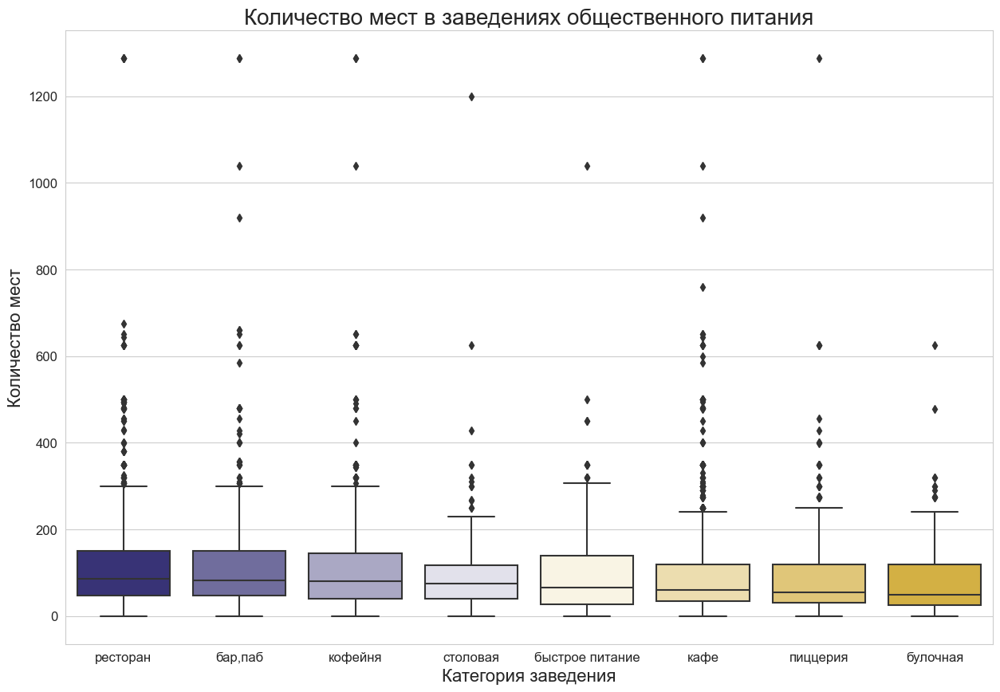

In [38]:
#визуализируем разброс значений
plt.figure(figsize=(15,10))
ranks = data.groupby('category')['seats'].median().fillna(0).sort_values()[::-1].index
sns.boxplot(x='category', y='seats', data=data,  order = ranks)
plt.title('Количество мест в заведениях общественного питания', fontsize=20)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlabel('Категория заведения', fontsize=16)
plt.ylabel('Количество мест', fontsize=16)
plt.show();

<p></p>

<div style="border:solid black 1px; padding: 20px">
Диапазон количества мест в заведениях общественного питания Москвы в максимуме приближается к 1400, однако все значения выше 300 относятся к выбросам. <p>  
</div>
<p></p>

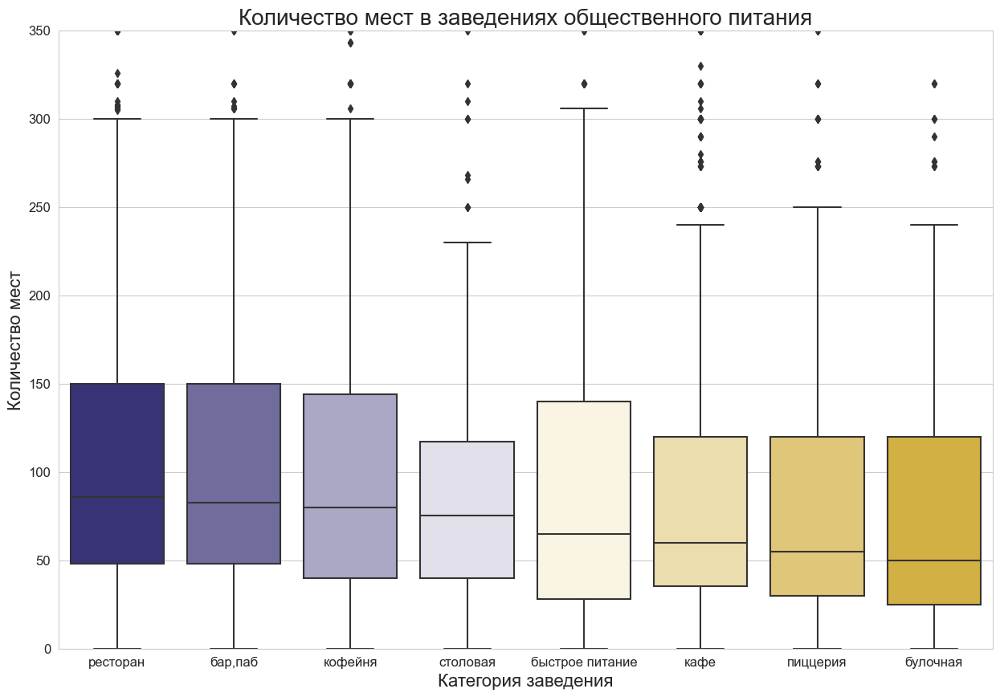

In [39]:
#укрупним диаграмму по границам нормальных значений
plt.figure(figsize=(15,10))
ranks = data.groupby('category')['seats'].median().fillna(0).sort_values()[::-1].index
sns.boxplot(x='category', y='seats', data=data,  order = ranks)
plt.title('Количество мест в заведениях общественного питания', fontsize=20)
plt.ylim(bottom=0, top=350)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlabel('Категория заведения', fontsize=16)
plt.ylabel('Количество мест', fontsize=16)
plt.show();

In [40]:
#оценим характеристики распределений
data.pivot_table(index='category', values='seats', aggfunc='describe')

,25%,50%,75%,count,max,mean,min,std
category,,,,,,,,
"бар,паб",48.00,82.5,150.0,468.0,1288.0,124.532051,0.0,145.011574
булочная,25.00,50.0,120.0,148.0,625.0,89.385135,0.0,97.685844
быстрое питание,28.00,65.0,140.0,349.0,1040.0,98.891117,0.0,106.611739
кафе,35.25,60.0,120.0,1218.0,1288.0,97.512315,0.0,117.985084
кофейня,40.00,80.0,144.0,751.0,1288.0,111.199734,0.0,127.837772
пиццерия,30.00,55.0,120.0,427.0,1288.0,94.496487,0.0,112.282703
ресторан,48.00,86.0,150.0,1270.0,1288.0,121.944094,0.0,123.757335
столовая,40.00,75.5,117.0,164.0,1200.0,99.750000,0.0,122.951453


<p></p>

<div style="border:solid black 1px; padding: 20px">
Самыми большими по количеству мест среди заведений общественного питания являются рестораны, медиана количества мест в ресторане составляет 86 мест, немного меньше бары и пабы, медианное количеством мест в которых составляет 82.5. Кофейни третьи по размеру с медианой равной 80 местам. В столовых чаще всего 75.5 мест, в заведениях быстрого притания - 65 мест, в кафе - 60 мест. Самые маленькие по количеству мест булочные, в которых чаще всего 50 мест, и пиццерии, в которых 55 мест.<p>  
</div>
<p></p>

#### Проанализируем соотношение сетевых и несетевых заведений:<a id='chain'></a> 

In [41]:
#рассчитаем значения для визуализации
data_chain=data.groupby('chain').agg({'name':'count'})
data_chain.columns=['count']
data_chain['labels']=['несетевыe','сетевыe']
data_chain

,count,labels
chain,,
0,5029,несетевыe
1,3377,сетевыe


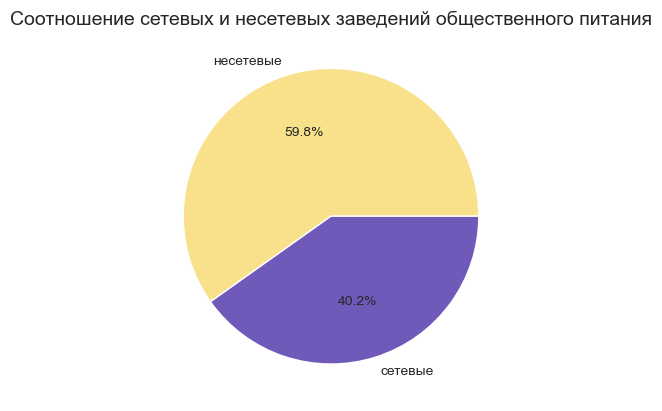

In [42]:
#для двух категорий подойтет круговая диаграмма
fig, ax = plt.subplots()
ax.pie(data_chain['count'], labels=data_chain['labels'], autopct='%1.1f%%', colors=['#F9E18B', '#6F5ABA'])
plt.title('Соотношение сетевых и несетевых заведений общественного питания', fontsize=14)
plt.show();

<p></p>

<div style="border:solid black 1px; padding: 20px">
Доля сетевых заведений общественного питания в Москве составляет 43.8%. Несетевых заведений больше половины - 56.2%<p>  
</div>
<p></p>

#### Визуализируем соотношение сетевых и несетевых заведений в разрезе категорий: <a id='chain_to_category'></a> 

In [43]:
#группируем данные для визуализации
data_chain_cat=data.pivot_table(index='category', columns='chain', values='name', aggfunc='count')
data_chain_cat.columns=['несетевые', 'сетевые']
data_chain_cat['total']=data_chain_cat.sum(axis=1)
data_chain_cat['несетевые']=(100*data_chain_cat['несетевые']/data_chain_cat['total']).round(2)
data_chain_cat['сетевые']=(100*data_chain_cat['сетевые']/data_chain_cat['total']).round(2)
del data_chain_cat['total']
data_chain_cat=data_chain_cat.sort_values('несетевые', ascending=False)
data_chain_cat

,несетевые,сетевые
category,,
"бар,паб",76.99,23.01
столовая,66.98,33.02
кафе,65.26,34.74
ресторан,62.90,37.10
быстрое питание,57.38,42.62
кофейня,46.92,53.08
пиццерия,46.13,53.87
булочная,35.55,64.45


In [44]:
#визуализируем данные
fig=px.bar(data_chain_cat, x=data_chain_cat.index, y=data_chain_cat.columns)
fig.update_layout(title_text='Соотношение сетевых и несетевых заведений общественного питания',
                 xaxis_title_text='Категории заведений',
                 yaxis_title_text='Доля заведений',
                 legend_title_text='Признак сети')
fig.show()

<p></p>

<div style="border:solid black 1px; padding: 20px">
Доля несетевых заведений существенно выше среди баров, пабов, кафе и ресторанов. Небольшой перевес несетевых наблюдается среди заведений быстрого питания и столовых. Среди кофеен, пиццерий и булочных, наоборот, чаще встречаются сетевые заведения.  
</div>
<p></p>

#### Оценим популярность сетевых заведений общественного питания: <a id='chain_top'></a> 

In [45]:
#расчитаем количество сетевых заведений общественного питания
chain_lid=data.query('chain==1').pivot_table(index='name', columns='category', values='lat', aggfunc='count')
chain_lid['Количество заведений']=chain_lid.sum(axis=1)
chain_lid=chain_lid.sort_values(by='Количество заведений', ascending=False)[0:15]
chain_lid

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,Количество заведений
name,,,,,,,,,
шоколадница,NaN,NaN,NaN,1.0,119.0,NaN,NaN,NaN,120.0
домино'спицца,NaN,NaN,NaN,NaN,NaN,77.0,NaN,NaN,77.0
додопицца,NaN,NaN,NaN,NaN,NaN,74.0,NaN,NaN,74.0
яндекс.лавка,NaN,NaN,NaN,NaN,NaN,NaN,72.0,NaN,72.0
onepricecoffee,NaN,NaN,NaN,NaN,72.0,NaN,NaN,NaN,72.0
cofix,NaN,NaN,NaN,NaN,65.0,NaN,NaN,NaN,65.0
prime,NaN,NaN,NaN,1.0,NaN,NaN,49.0,NaN,50.0
хинкальная,3.0,NaN,6.0,19.0,NaN,NaN,15.0,1.0,44.0
кофепорт,NaN,NaN,NaN,NaN,42.0,NaN,NaN,NaN,42.0


In [46]:
#сгруппируем на одном поле средние и медианные значения рейтинка по категориям и общий
fig = px.bar(chain_lid, x=chain_lid.index, y='Количество заведений',
             color='Количество заведений', barmode='group', color_continuous_scale=ccscale2)
fig.update_layout(title_text='Top-15 наиболее популярных сетевых заведений общественного питания', 
                  barmode='stack', xaxis={'categoryorder':'total descending'},
                  xaxis_title_text='Названия заведений')
fig.show();

<p></p>

<div style="border:solid black 1px; padding: 20px">
Наиболее часто в Москве встречаются заведения сети "Шоколадница". В пятерку лидеров входят также "Домино'с пицца", "Додопицца", "Яндекс.Лавка" и "OnePriceCoffee". 
 
</div>
<p></p>

#### Визуализируем категории заведений лидеров рейтинга среди сетевых заведений: <a id='chain_top_cat'></a> 

In [47]:
#пересчитаем доли категорий
chain_lid_perc=(chain_lid.div(chain_lid['Количество заведений'], axis=0)*100).round(2)
chain_lid_perc

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,Количество заведений
name,,,,,,,,,
шоколадница,NaN,NaN,NaN,0.83,99.17,NaN,NaN,NaN,100.0
домино'спицца,NaN,NaN,NaN,NaN,NaN,100.0,NaN,NaN,100.0
додопицца,NaN,NaN,NaN,NaN,NaN,100.0,NaN,NaN,100.0
яндекс.лавка,NaN,NaN,NaN,NaN,NaN,NaN,100.00,NaN,100.0
onepricecoffee,NaN,NaN,NaN,NaN,100.00,NaN,NaN,NaN,100.0
cofix,NaN,NaN,NaN,NaN,100.00,NaN,NaN,NaN,100.0
prime,NaN,NaN,NaN,2.00,NaN,NaN,98.00,NaN,100.0
хинкальная,6.82,NaN,13.64,43.18,NaN,NaN,34.09,2.27,100.0
кофепорт,NaN,NaN,NaN,NaN,100.00,NaN,NaN,NaN,100.0


In [48]:
#построим столбчатую диаграмму с накоплением
fig=px.bar(chain_lid_perc, x=chain_lid_perc.index, y=chain_lid_perc.columns[0:8], 
           color_discrete_sequence=pal_colors)
fig.update_layout(title_text='Категории заведений общественного питания наиболее популярных сетей',
                 xaxis_title_text='Названия заведений',
                 yaxis_title_text='Доля заведений',
                 legend_title_text='Категория заведений')
fig.update_xaxes(tickangle=45, automargin=True)
fig.show();

<p></p>

<div style="border:solid black 1px; padding: 20px">
Большинство сетей диверсифицируют бизнес, открывая заведения различных категорий, даже если это всего одно заведение из сотни. Из 15 лидеров только у 7 сетей открыты заведения одной категории. Треть самых популярных сетей общественного питания составляют кофейни: "Шоколадница", "OnePriceCoffee", "Cofix", "Кофепорт" и "Cofefest".
 
</div>
<p></p>

#### Визуализируем рейтинг самых популярных сетевых заведений: <a id='chain_top_rat'></a> 

In [49]:
#рассчитаем средний рейтинг всех заведений
print(f'Средний рейтинг заведений общественного питания в Москве составляет', data['rating'].mean().round(2))

Средний рейтинг заведений общественного питания в Москве составляет 4.23


In [50]:
#рассчитаем средний рейтинг популярных сетей
chain_lid_top=chain_lid.sort_values(by='Количество заведений', ascending=False).head(15).index
data_chain_lid=data.query('name in @chain_lid_top').groupby('name').agg({'rating':('count','mean')}).sort_values(('rating','count'), ascending=False)
data_chain_lid.columns=['Количество заведений','Рейтинг']
data_chain_lid

,Количество заведений,Рейтинг
name,,
шоколадница,120,4.177500
домино'спицца,77,4.171429
додопицца,74,4.286486
onepricecoffee,72,4.069444
яндекс.лавка,72,3.855556
cofix,65,4.075385
prime,50,4.116000
хинкальная,44,4.322727
кофепорт,42,4.147619


In [51]:
#визуализируем рейтинг наиболее популярных сетей
fig = px.scatter(data_chain_lid, x=data_chain_lid.index, y='Рейтинг',
                 color='Количество заведений', color_continuous_scale=ccscale2)
fig.update_layout(title_text='Оценки лидеров рейтинга сетевых заведений общественного питания',
                 xaxis_title_text='Названия заведений')
fig.update_traces(marker_size=10*data_chain_lid['Рейтинг'])
fig.update_xaxes(tickangle=45, automargin=True)
fig.show()

<p></p>

<div style="border:solid black 1px; padding: 20px">
Количество заведений не гарантирует высокого рейтинга, так рейтинг "Шоколадницы" ниже среднего по городу, а лидерами по оценкам клиентов являются кафе "Кулинарна лавка братьев Караваевых" и заведения сети "Буханка".  
</div>
<p></p>

#### Визуализируем расположение заведений общественного питания на карте:<a id='category_to_district'></a> 

In [52]:
#рассчитаем данные для визуализации
data_district=data.pivot_table(index='district', columns='category', values='name', aggfunc=('count'))
data_district['total']=data_district.sum(axis=1)
data_district['Административный округ']=data['district'].sort_values().unique()
data_district['Административный округ']=data_district['Административный округ'].str.replace(' административный округ','')
data_district

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,total,Административный округ
district,,,,,,,,,,
Восточный административный округ,53,25,71,272,105,72,160,40,798,Восточный
Западный административный округ,50,37,62,239,150,71,218,24,851,Западный
Северный административный округ,68,39,58,235,193,77,189,41,900,Северный
Северо-Восточный административный округ,63,28,82,269,159,68,182,40,891,Северо-Восточный
Северо-Западный административный округ,23,12,30,115,62,40,109,18,409,Северо-Западный
Центральный административный округ,364,50,87,464,428,113,670,66,2242,Центральный
Юго-Восточный административный округ,38,13,67,282,89,55,145,25,714,Юго-Восточный
Юго-Западный административный округ,38,27,61,238,96,64,168,17,709,Юго-Западный
Южный административный округ,68,25,85,264,131,73,202,44,892,Южный


In [53]:
#построим столбчатую диаграмму с накоплением
fig=px.bar(data_district, x='Административный округ', y=data_district.columns[0:8], 
           color_discrete_sequence=pal_colors)
fig.update_layout(title_text='Расположение заведений общественного питания Москвы по округам',
                 xaxis_title_text='Административный округ',
                 yaxis_title_text='Количество заведений',
                 legend_title_text='Категория заведений',
                 xaxis = {"categoryorder":"total descending"})
fig.update_xaxes(tickangle=45, automargin=True)
fig.show();

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Наибольшее количество заведений общественного питания расположено в Центральном административном округе (2242), в этом же округе наибольшая доля ресторанов и кофеен. В остальных округах количество заведений общественного питания не превышает 1000 (от 700 до 900 заведений в каждом округе), и более распространены кафе. Меньше всего заведений общественного питания (409) в Северо-Западном округе, почти половину площади которого занимают природные ландшафты — лесопарковые массивы, водоёмы, заповедные зоны.
</div>
<p></p>

#### Визуализируем распределение средних рейтингов по категориям заведений:<a id='category_to_rating'></a> 

In [54]:
#рассчитаем средние и медианные значения рейтинга по категориям и общий
chain_rating_cat=data.pivot_table(index='category', values='rating', aggfunc=('mean','median','count'))
chain_rating_cat.columns=['Количество заведений', 'Средний рейтинг категории', 'Медиана рейтинга категории']
chain_rating_cat['Средний рейтинг']=data['rating'].mean()
chain_rating_cat['Медиана рейтинга']=data['rating'].median()
chain_rating_cat=chain_rating_cat.sort_values('Средний рейтинг категории', ascending=False)
chain_rating_cat

,Количество заведений,Средний рейтинг категории,Медиана рейтинга категории,Средний рейтинг,Медиана рейтинга
category,,,,,
"бар,паб",765,4.387712,4.4,4.229895,4.3
пиццерия,633,4.301264,4.3,4.229895,4.3
ресторан,2043,4.290357,4.3,4.229895,4.3
кофейня,1413,4.277282,4.3,4.229895,4.3
булочная,256,4.268359,4.3,4.229895,4.3
столовая,315,4.211429,4.3,4.229895,4.3
кафе,2378,4.123886,4.2,4.229895,4.3
быстрое питание,603,4.050249,4.2,4.229895,4.3


In [55]:
#сгруппируем на одном поле средние и медианные значения рейтинга по категориям и общий
fig = go.Figure()
fig.add_trace(go.Bar(x=chain_rating_cat.index, y=chain_rating_cat['Средний рейтинг категории'],  name='Средний рейтинг категории'))
fig.add_trace(go.Bar(x=chain_rating_cat.index, y=chain_rating_cat['Медиана рейтинга категории'],  name='Медиана рейтинга категории'))
fig.add_trace(go.Scatter(x=chain_rating_cat.index, y=chain_rating_cat['Средний рейтинг'],  mode='lines+markers', marker_size=15, name='Средний рейтинг'))
fig.add_trace(go.Scatter(x=chain_rating_cat.index, y=chain_rating_cat['Медиана рейтинга'],  mode='lines+markers', marker_size=15, name='Медиана рейтинга'))
fig.update_layout(title_text='Рейтинг заведений общественного питания различных категорий', 
                  barmode='group',
                  xaxis_title_text='Категория заведений',
                  yaxis_title_text='Рейтинг',
                  yaxis_range=[4.0,4.5])
fig.show();

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Пользователи чаще всего дают заведениям общественного питания хорошие оценки - медиана рейтинга составляет 4.3, для всех категорий медиана укладывается в диапазон 4.3+/-0.1. Средняя оценка рейтинга всех заведений ниже медианного значения, что свидетельствует о том, что плохие оценки довольно редки и статистически относятся к выбросам.<p>
    Наиболее высокий рейтинг в среднем у баров и пабов - 4.38. Пиццерии,рестораны, кофейни и булочные оцениваются в среднем от 4.26 до 4.3. Столовые получают в среднем оценку 4.21. Наиболее критичны пользователи к заведениям быстрого питания, которые оцениваются в среднем в 4.05, и кафе - со средним рейтингом 4.12. Различие между лидером и замыкающим в среднем рейтинге составляет 0.33 балла рейтинговой оценки.
    
</div>
<p></p>

#### Визуализируем средний рейтинг заведений каждого округа:<a id='rating_to_district'></a> 

In [56]:
#рассчитаем рейтинг заведений по округам
data_rating_dis=data.pivot_table(index='district', values='rating', aggfunc='mean')
data_rating_dis.columns=['rating']
data_rating_dis['district']=data['district'].sort_values().unique()
data_rating_dis

,rating,district
district,,
Восточный административный округ,4.174185,Восточный административный округ
Западный административный округ,4.181551,Западный административный округ
Северный административный округ,4.239778,Северный административный округ
Северо-Восточный административный округ,4.148260,Северо-Восточный административный округ
Северо-Западный административный округ,4.208802,Северо-Западный административный округ
Центральный административный округ,4.377520,Центральный административный округ
Юго-Восточный административный округ,4.101120,Юго-Восточный административный округ
Юго-Западный административный округ,4.172920,Юго-Западный административный округ
Южный административный округ,4.184417,Южный административный округ


In [57]:
#загружаем файлы geojson
try:
    geomap=geopandas.read_file('\\dataset\\admin_level_geomap.geojson')
except:
    geomap=geopandas.read_file('/datasets/admin_level_geomap.geojson')

In [58]:
#визуализируем средний рейтинг заведений по округам
map_center = {'lat': data['lat'].mean(), 'lon': data['lng'].mean()}
fig = px.choropleth_mapbox(
        data_rating_dis, geojson=geomap, color='rating',
        locations=data_rating_dis.index, featureidkey='properties.name',
        center=map_center, zoom=8.5,
        mapbox_style='open-street-map', opacity=0.7,
        color_continuous_scale=ccscale)

fig.update_geos(fitbounds='locations', visible=False)
fig.update_layout(margin={'r':0,'t':0,'l':0,'b':0})
fig.show()

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Наиболее высокий рейтинг в среднем у заведений общественного питания в Центральном районе - 4.37. Выше среднего рейтинг заведений Северного административного округа - 4.24. Средний рейтинг заведений в прочих административных округах ниже среднего рейтинга по Москве в целом - в диапазоне от 4.15 до 4.2. Самые низние оценки у заведений общественного питания Юго-Восточного административного округа - 4.1.
</div>
<p></p>

#### Визуализируем расположение заведений:<a id='address_clusters'></a> 

In [59]:
moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

data.apply(create_clusters, axis=1)

m

<p></p>

<div style="border:solid black 1px; padding: 20px">
   Уже в первом приближении заметно концентрация заведений общественного питания в Центре столицы. Чем дальше от центра, тем меньше количество объектов и мельче кластеры на карте.
</div>
<p></p>

In [60]:
data_dis=data.pivot_table(index='district', values='name', aggfunc='count')
data_dis['district']=data['district'].sort_values().unique()
data_dis

,name,district
district,,
Восточный административный округ,798,Восточный административный округ
Западный административный округ,851,Западный административный округ
Северный административный округ,900,Северный административный округ
Северо-Восточный административный округ,891,Северо-Восточный административный округ
Северо-Западный административный округ,409,Северо-Западный административный округ
Центральный административный округ,2242,Центральный административный округ
Юго-Восточный административный округ,714,Юго-Восточный административный округ
Юго-Западный административный округ,709,Юго-Западный административный округ
Южный административный округ,892,Южный административный округ


In [61]:
#визуализируем плотность размещения заведений по округам
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth = folium.Choropleth(geo_data=geomap,
    data=data_dis,
    columns=['district','name'],
    key_on='properties.name',
    fill_color='Blues',
    fill_opacity=0.7).add_to(m)
m

#### Проанализируем расположение заведений по улицам: <a id='street'></a> 

In [62]:
#рассчитаем количество заведений в разрезе улиц
data_street=data.pivot_table(index='street', columns='category', values='name', aggfunc='count')
data_street.columns=['бар,паб','булочная','быстрое питание','кафе','кофейня','пиццерия','ресторан','столовая']
data_street['total']=data_street.sum(axis=1)
data_street=data_street.sort_values(by='total', ascending=False)
data_street_lid=data_street.drop('total', axis=1)[0:15]
data_street

,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,total
street,,,,,,,,,
проспект Мира,12.0,4.0,21.0,53.0,36.0,11.0,45.0,2.0,184.0
Профсоюзная улица,6.0,4.0,15.0,35.0,18.0,15.0,26.0,3.0,122.0
Ленинский проспект,10.0,3.0,2.0,26.0,24.0,5.0,33.0,5.0,108.0
проспект Вернадского,7.0,1.0,12.0,25.0,16.0,12.0,33.0,2.0,108.0
Ленинградский проспект,15.0,4.0,2.0,12.0,25.0,9.0,25.0,3.0,95.0
...,...,...,...,...,...,...,...,...,...
Девяткин переулок,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
Даев переулок,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0
Электрический переулок,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0


In [63]:
#рассчитаем средние тенденции 
print('Среднее количество заведений на одной улице', data_street['total'].mean())
print('Медиана количества заведений на одной улице', data_street['total'].median())

Среднее количество заведений на одной улице 5.668240053944706
Медиана количества заведений на одной улице 3.0


<p></p>

<div style="border:solid black 1px; padding: 20px">
   В среднем на одной улице в Москве располагаются более 5 заведений общественного питания, медиана количества заведений равна 3. Самая насышенная заведениями улица - проспект Мира, где расположены 184 заведения. Более 100 заведений общественного питания расположены на Профсоюзной улице, проспекте Вернадского, Ленинском и Ленинградском проспектах.  
</div>
<p></p>

In [64]:
#пересчитаем доли категорий
data_street_lid_perc=data_street.div(data_street['total'], axis=0)
data_street_lid_perc=data_street_lid_perc[0:15].drop('total', axis=1)
data_street_lid_perc=data_street_lid_perc.sort_values('проспект Мира', axis=1, ascending=False)
data_street_lid_perc

,кафе,ресторан,кофейня,быстрое питание,"бар,паб",пиццерия,булочная,столовая
street,,,,,,,,
проспект Мира,0.288043,0.244565,0.195652,0.114130,0.065217,0.059783,0.021739,0.010870
Профсоюзная улица,0.286885,0.213115,0.147541,0.122951,0.049180,0.122951,0.032787,0.024590
Ленинский проспект,0.240741,0.305556,0.222222,0.018519,0.092593,0.046296,0.027778,0.046296
проспект Вернадского,0.231481,0.305556,0.148148,0.111111,0.064815,0.111111,0.009259,0.018519
Ленинградский проспект,0.126316,0.263158,0.263158,0.021053,0.157895,0.094737,0.042105,0.031579
Дмитровское шоссе,0.261364,0.272727,0.125000,0.113636,0.068182,0.090909,0.022727,0.045455
Каширское шоссе,0.259740,0.246753,0.207792,0.129870,0.025974,0.064935,NaN,0.064935
Варшавское шоссе,0.236842,0.263158,0.184211,0.092105,0.078947,0.052632,NaN,0.092105
Ленинградское шоссе,0.185714,0.371429,0.185714,0.071429,0.071429,0.042857,0.028571,0.042857


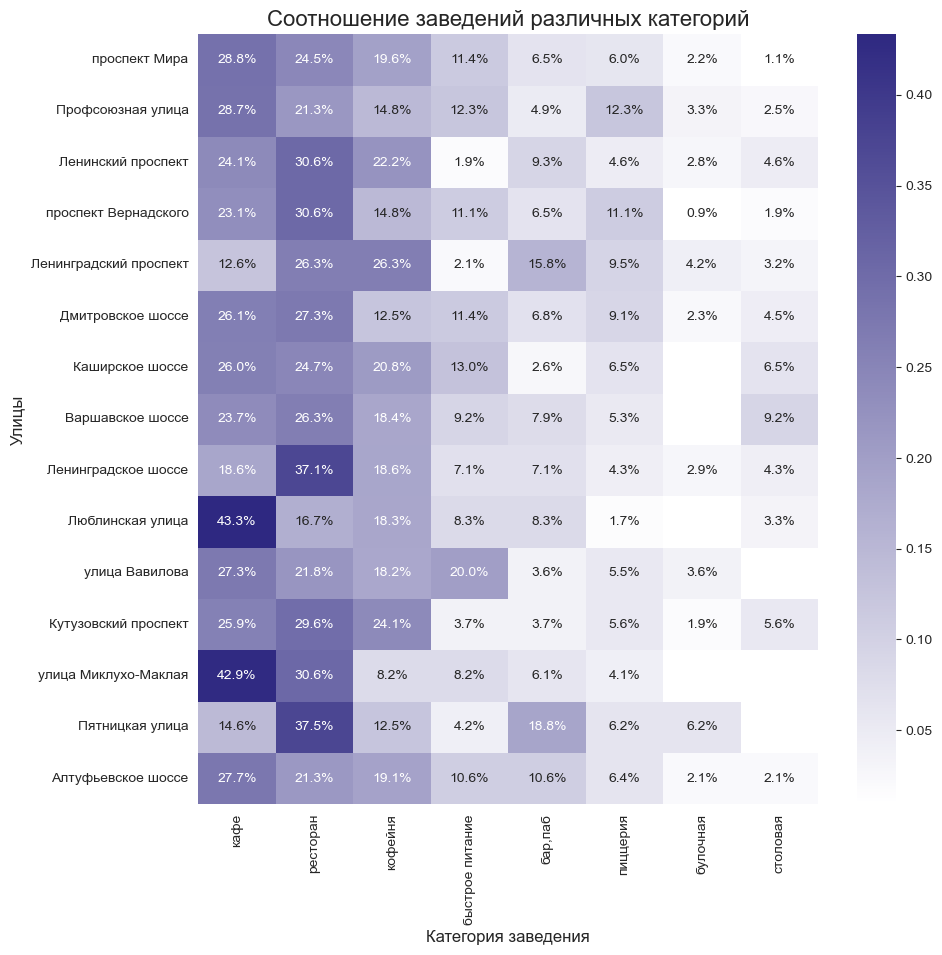

In [65]:
#визуализируем количество заведений разных категорий на наиболее загруженных улицах
plt.figure(figsize=(10,10))
sns.set_style('white')
sns.heatmap(data_street_lid_perc, annot=True, cmap=my_sns_pal_c, fmt=".1%")
plt.title('Соотношение заведений различных категорий', fontsize=16)
plt.ylabel('Улицы', fontsize=12)
plt.xlabel('Категория заведения', fontsize=12)
plt.show();

<p></p>

<div style="border:solid black 1px; padding: 20px">
   В отношениии наиболее загруженных улиц сохраняется тенденция преобладания кафе и ресторанов, хотя имеются и исключения, например, на Ленинградском проспекте кафе лишь 18%, там по количеству опережают бары и кофейни. Меньше всего представлены булочные и столовые, есть улицы из числа лидеров по количеству заведений общественного питания, где заведения этих категорий отсутствуют.
</div>
<p></p>

#### Проанализируем заведения, имеющие уникальное название улицы: <a id='one_place_street'></a> 

In [66]:
#выделим улицы, на которых расположено одно заведение общественного питания
single_street=data_street.query('total==1').index
single_street

Index(['2-й Вышеславцев переулок', 'улица Губкина',
       '2-й Новоподмосковный переулок', '2-й Зачатьевский переулок',
       'Бесединское шоссе', 'улица Усиевича', '2-й Кожуховский проезд',
       'Басманный тупик', '2-й Полевой переулок', 'улица Стасовой',
       ...
       'Дербеневская улица', 'Дендропарковая улица', 'Грузинский сквер',
       'Делегатская улица', 'Шоссейный проезд', 'Девяткин переулок',
       'Даев переулок', 'Электрический переулок', 'Гурьевский проезд',
       '1-й Автозаводский проезд'],
      dtype='object', name='street', length=477)

In [67]:
#сравним характеристики заведений с общей выборкой
data_single=data.query('street in @single_street')
print('Количество заведений', len(data_single))
print('Доля заведений', len(data_single)/len(data))
print('Общий средний рейтинг', data['rating'].mean())
print('Средний рейтинг выборки', data_single['rating'].mean())
print('Общая доля сетевых', (data.query('chain==1')['chain'].count()/data['chain'].count()))
print('Доля сетевых выборки', (data_single.query('chain==1')['chain'].count()/data_single['chain'].count()))

Количество заведений 477
Доля заведений 0.056745182012847964
Общий средний рейтинг 4.229895312871758
Средний рейтинг выборки 4.237526205450734
Общая доля сетевых 0.4017368546276469
Доля сетевых выборки 0.32075471698113206


In [68]:
#визуализируем расположение таких заведений на карте
map_center = {'lat': data['lat'].mean(), 'lon': data['lng'].mean()}
fig = px.scatter_mapbox(data_single, lat='lat', lon='lng', mapbox_style='open-street-map', center=map_center, zoom=8.5, text='name', 
                        color='category',  color_discrete_sequence=pal_colors)
fig.update_layout(title_text='Расположение улиц с единственным заведением общественного питания',
                 legend_title_text='Категория заведения')
fig.update_traces(showlegend=True, marker_size=10)
fig.show()

<p></p>

<div style="border:solid black 1px; padding: 20px">
Заведения общественного питания, располагающиеся на улице в единственном числе, существенно не отличаются от общей массы - доля таких заведений - менее 6%, расположены во всех округах, представлены все категории заведений, средний рейтинг выше на 0.06 балла, доля сетевых заведений ниже на 5%, сохраняется тенденция к концентрации в центре столицы.
</div>
<p></p>

#### Проанализируем стоимость заказов: <a id='avg_bill'></a> 

In [69]:
#выведем характеристики распределения всей выборки
data['middle_avg_bill'].describe()

count     3149.000000
mean       958.053668
std       1009.732845
min          0.000000
25%        375.000000
50%        750.000000
75%       1250.000000
max      35000.000000
Name: middle_avg_bill, dtype: float64

<p></p>

<div style="border:solid black 1px; padding: 20px">
Значения среднего счета в заведениях общественого питания в Москве разбросаны в диапазоне от 0 до 35000. Медиана среднего чека составляет 750, среднее значение выше - 958, что говорит о наличии аномально больших значений в отдельных заведениях.
</div>
<p></p>

In [70]:
#выведем характеристики распределения по категориям
bill_cat=data.pivot_table(index='category', values='middle_avg_bill', aggfunc='describe')
bill_cat=bill_cat.sort_values('50%',ascending=False)
bill_cat

,25%,50%,75%,count,max,mean,min,std
category,,,,,,,,
"бар,паб",925.00,1250.0,1750.0,349.0,11000.0,1338.762178,150.0,885.669721
ресторан,668.75,1250.0,1750.0,1040.0,35000.0,1367.881731,120.0,1415.022183
пиццерия,424.00,600.0,1000.0,395.0,3000.0,789.377215,150.0,518.310744
кафе,350.00,550.0,1000.0,694.0,4500.0,707.753602,67.0,505.126951
булочная,285.00,450.0,750.0,53.0,2500.0,658.773585,50.0,599.468439
кофейня,300.00,400.0,750.0,200.0,2500.0,614.210000,0.0,501.083154
быстрое питание,275.00,375.0,500.0,237.0,5500.0,445.763713,30.0,456.092666
столовая,250.00,300.0,330.0,181.0,3750.0,335.348066,125.0,289.213253


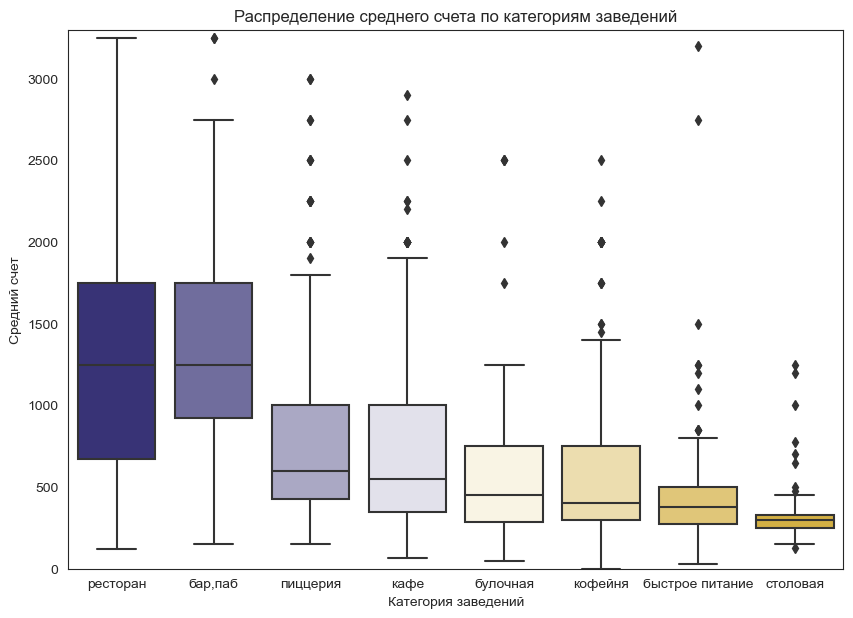

In [71]:
#визуализируем распределения по категориям
plt.figure(figsize=(10,7))
ranks = data.groupby('category')['middle_avg_bill'].median().fillna(0).sort_values()[::-1].index
sns.boxplot(x='category', y='middle_avg_bill', data=data,  order = ranks)
plt.ylim(bottom=0, top=3300)
plt.title('Распределение среднего счета по категориям заведений')
plt.xlabel('Категория заведений')
plt.ylabel('Средний счет')
plt.show();

In [72]:
#определим самое дорогое заведение
max_bill=data['middle_avg_bill'].max()
print('Самый большой средний счет в', data.loc[(data['middle_avg_bill']==max_bill),'category'].values[0], data.loc[(data['middle_avg_bill']==max_bill),'name'].values[0], data.query('middle_avg_bill==@max_bill')['district'].values[0])

Самый большой средний счет в ресторан кафе Южный административный округ


<p></p>

<div style="border:solid black 1px; padding: 20px">
Самый высокий средний счет в медианных значениях у ресторанов и баров - 1250. В других категориях заведений медиана среднего счета ниже в разы - в пиццерии посетители оставляют 600, в кафе - 550, в прочих заведениях - менее 500. Дешевле всего обходится питание в столовых, медианное значение среднего чека равно 300.<p>
Самый большой средний счет получен в ресторане, который называется "Кафе", находящемся в Южном округе Москвы. 
</div>
<p></p>

#### Проанализируем стоимость заказов по округам: <a id='avg_bill_to_district'></a> 

In [73]:
#рассчитаем средний счет по округам
bill_dis=data.pivot_table(index='district', values='middle_avg_bill', aggfunc='median')
bill_dis.columns=['Средний счет']
bill_dis['district']=data['district'].sort_values().unique()
bill_dis

,Средний счет,district
district,,
Восточный административный округ,575.0,Восточный административный округ
Западный административный округ,1000.0,Западный административный округ
Северный административный округ,650.0,Северный административный округ
Северо-Восточный административный округ,500.0,Северо-Восточный административный округ
Северо-Западный административный округ,700.0,Северо-Западный административный округ
Центральный административный округ,1000.0,Центральный административный округ
Юго-Восточный административный округ,450.0,Юго-Восточный административный округ
Юго-Западный административный округ,600.0,Юго-Западный административный округ
Южный административный округ,500.0,Южный административный округ


In [74]:
#визуализируем плотность размещения заведений по округам
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth = folium.Choropleth(geo_data=geomap,
    data=bill_dis,
    columns=['district','Средний счет'],
    key_on='properties.name',
    fill_color='Blues',
    fill_opacity=0.7).add_to(m)
m

<p></p>

<div style="border:solid black 1px; padding: 20px">
Наиболее высокий средний счет (1000) в заведениях общественного питания в Центральном и Западном администратичных округах столицы, самый низкий средний чек (450) - в Юго-Восточном округе. В прочих округах средний счет колеблется в диапазоне от 500 до 700.
</div>
<p></p>

In [75]:
#отметим маркерами все заведения
fig = px.scatter_mapbox(data.dropna(subset=['middle_avg_bill']), lat='lat', lon='lng', mapbox_style='open-street-map', center=map_center, zoom=8.5, text='name', 
                        color='middle_avg_bill',  color_continuous_scale='Reds', range_color=[250, 2000])
fig.update_layout(title_text='Средний счет заведений общественного питания',
                 legend_title_text='Средний счет')
fig.update_traces(showlegend=True, marker_size=7)
fig.show()

<p></p>

<div style="border:solid black 1px; padding: 20px">
На карте видно, что во всех округах столицы находятся как догоростоящие, так и бюджетные заведения общественного питания, хотя в центре концентрация заведений с дорогими заказами выше. Оставим на карте только выбросы.
</div>
<p></p>

In [76]:
#визуализируем расположение заведений с наибольшим средним счетом
fig = px.scatter_mapbox(data.dropna(subset=['middle_avg_bill']).query('middle_avg_bill>2000'), lat='lat', lon='lng', mapbox_style='open-street-map', center=map_center, zoom=8.5, text='name', 
                        color='middle_avg_bill',  color_continuous_scale='Reds', range_color=[0, 10000])
fig.update_layout(title_text='Расположение заведений общественного питания с наибольшим средним счетом',
                 legend_title_text='Средний счет')
fig.update_traces(showlegend=True, marker_size=10)
fig.show()

<p></p>

<div style="border:solid black 1px; padding: 20px">
На этой диаграмме подтверждается, что в Центральном округе больше заведений с высоким средним счетом, чем в остальных округах, хотя три самые дорогие заведения расположены в других округах.
</div>
<p></p>

#### Проанализируем расположение заведений с круглосуточным режимом работы: <a id='24_7_to_district'></a> 

In [77]:
#Отметим на карте расположение заведений
fig = px.scatter_mapbox(data, lat='lat', lon='lng', mapbox_style='open-street-map', center=map_center, zoom=8.5, text='name', 
                        color='is_24/7')
fig.update_layout(title_text='Расположение заведений общественного питания с режимом работы 24/7',
                 legend_title_text='Круглосуточный режим работы')
fig.update_traces(showlegend=True, marker_size=10)
fig.show()

In [78]:
#расположение похоже на равномерное рассеяние, подтвердим наблюдения расчетами
bill_dis=data.pivot_table(index='district', values='is_24/7', aggfunc=('sum','count'))
bill_dis['24/7']=(100*bill_dis['sum']/bill_dis['count']).round(2)
bill_dis.sort_values('count')

,count,sum,24/7
district,,,
Северо-Западный административный округ,409,43,10.51
Юго-Западный административный округ,709,73,10.30
Юго-Восточный административный округ,714,93,13.03
Восточный административный округ,798,97,12.16
Западный административный округ,851,72,8.46
Северо-Восточный административный округ,891,75,8.42
Южный административный округ,892,75,8.41
Северный административный округ,900,71,7.89
Центральный административный округ,2242,131,5.84


<p></p>

<div style="border:solid black 1px; padding: 20px">
Заведения общественного питания с круглосуточным режимом работы расположены во всех округах относительно равномерно, здесь не наблюдается сильной концентрации в центре, как по всей выборке, наоборот, в Центральном округе наименьшая доля круглосуточных заведений, а в округах с наименьшим общим числом заведений питания доля круглосуточных заведений максимальна.
</div>
<p></p>

#### Проанализируем различия в стоимости заказов круглосуточных заведений:<a id='avg_bill_to_24_7'></a> 

In [79]:
#рассчитаем средний счет в заведениях с разным режимом работы
bill_24_7=data.pivot_table(index='is_24/7', values='middle_avg_bill', aggfunc=('mean','median'))
bill_24_7

,mean,median
is_24/7,,
False,966.633254,750.0
True,847.088496,425.0


In [80]:
# у круглосуточных средний счет меньше, уточним расчет по категориям заведений
bill_24_7=data.pivot_table(index='category', columns='is_24/7', values='middle_avg_bill', aggfunc=('mean','median'))
bill_24_7.columns=['Средний счет некруглосуточные', 'Средний счет 24/7', 'Медианный счет некруглосуточные','Медианный счет 24/7']
bill_24_7['Средний счет разница']=(100*bill_24_7['Средний счет 24/7']/bill_24_7['Средний счет некруглосуточные']).round(2)
bill_24_7['Медианный счет разница']=(100*bill_24_7['Медианный счет 24/7']/bill_24_7['Медианный счет некруглосуточные']).round(2)
bill_24_7

,Средний счет некруглосуточные,Средний счет 24/7,Медианный счет некруглосуточные,Медианный счет 24/7,Средний счет разница,Медианный счет разница
category,,,,,,
"бар,паб",1347.690909,1183.684211,1250.0,1250.0,87.83,100.00
булочная,728.255814,360.000000,500.0,250.0,49.43,50.00
быстрое питание,486.836842,279.723404,400.0,300.0,57.46,75.00
кафе,722.354992,561.507937,600.0,425.0,77.73,70.83
кофейня,557.978610,1423.076923,400.0,1750.0,255.04,437.50
пиццерия,802.635884,475.312500,600.0,350.0,59.22,58.33
ресторан,1352.050710,1656.944444,1250.0,900.0,122.55,72.00
столовая,335.864407,312.500000,300.0,312.5,93.04,104.17


<p></p>

<div style="border:solid black 1px; padding: 20px">
Для большинства категорий работать круглосуточно невыгодно, средний счет заведений, работающих в режиме 24/7 средний счет ниже работающих в другие часы. <p>
    Исключение составляют бары и пабы, у которых размер счета не меняется, а также столовые, в которых средний счет минимален. <p>
    Кардинально отличается ситуация для кофеен - средний счет круглосуточных кофеен выше в 4 раза, по сравнению с работающими в другом режиме.
</div>
<p></p>

#### Проанализируем связь среднего счета и рейтинга заведения:<a id='avg_bill_to_rating'></a> 

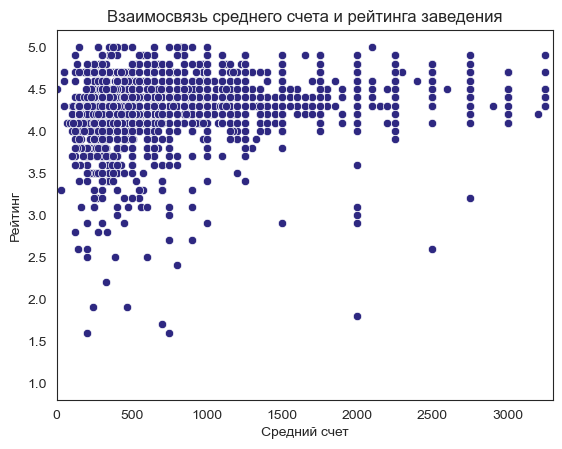

In [81]:
#выведем диаграмму рассеяния
sns.scatterplot(x='middle_avg_bill', y='rating', data=data)
plt.xlim(0, 3300)
plt.title('Взаимосвязь среднего счета и рейтинга заведения')
plt.xlabel('Средний счет')
plt.ylabel('Рейтинг')
plt.show();

In [82]:
#рассчитаем корреляцию
data_corr=data[['rating', 'middle_avg_bill']]
data_corr.corr()

,rating,middle_avg_bill
rating,1.000000,0.183238
middle_avg_bill,0.183238,1.000000


<p></p>

<div style="border:solid black 1px; padding: 20px">
Статистически значимой корреляции между величиной среднего счета заведения и его рейтингом не наблюдается.
</div>
<p></p>



### Вывод <a id='summary_analysis'></a> 

<p></p>

<div style="border:solid green 2px; padding: 20px">
Мы изучили информацию о 8406 заведениях общественного питания в Москве, более половины которых представлена кафе и ресторанами.  Доля кофеен в Москве - 16.8% заведений общественного питания. Оставшаяся треть - это пабы и бары, пиццерии, заведения быстрого питания, булочные и столовые.<p>
    Количество мест в заведениях общественного питания в среднем не превышает 100 мест: от 86 мест в ресторанах до булочных, в которых в среднем 50 мест. <p>   
        Доля сетевых заведений общественного питания в Москве составляе 43.8%, чаще к ним относятся кофейни, пиццерии и булочные. Несетевых заведений  чуть больше половины - 56.2%, этот показатель выше для баров, пабов, кафе и ресторанов. <p>
    Наибольшее количество заведений общественного питания расположено в Центральном административном округе, в этом же округе наибольшая доля ресторанов и кофеен. В остальных округах количество заведений общественного питания составляет от 700 до 900 заведений, и более распространены кафе. Меньше 500 заведений общественного питания в Северо-Западном округе.<p>   В среднем на одной улице в Москве располагаются более 5 заведений общественного питания, медиана количества заведений равна 3. Самая насышенная заведениями улица - проспект Мира, где расположены 184 заведения. Более 100 заведений общественного питания расположены на Профсоюзной улице, проспекте Вернадского, Ленинском и Ленинградском проспектах.<p> 
   Наиболее высокий рейтинг в среднем у заведений общественного питания в Центральном районе - 4.37. Самые низние оценки у заведений общественного питания Юго-Восточного административного округа - 4.1. <p>
    Пользователи чаще всего дают заведениям общественного питания хорошие оценки - медиана рейтинга составляет 4.3, для всех категорий медиана укладывается в диапазон 4.3+/-0.1. 
    Средняя оценка рейтинга заведений, как правило, ниже медианного значения, что свидетельствует о том, что плохие оценки довольно редки и статистически относятся к выбросам. Наиболее высокий рейтинг в среднем у баров и пабов - 4.38. Наиболее критичны пользователи к заведениям быстрого питания, которые оцениваются в среднем в 4.05, и кафе - со средним рейтингом 4.12. Связи рейтинга со средним счетом не обнаружено.<p>  
  Значение медианы среднего счета в заведениях общественого питания в Москве составляет 750, среднее значение выше - 958, что говорит о наличии аномально больших значений в отдельных заведениях.Самый высокий средний счет в медианных значениях у ресторанов и баров - 1250. В других категориях заведений медиана среднего счета не превышает 600. Дешевле всего обходится питание в столовых, где средний чек составляет 300.<p>
Наиболее высокий средний счет в заведениях общественного питания в Центральном и Западном администратичных округах столицы, самый низкий средний чек - в Юго-Восточном округе. <p>
    Заведения общественного питания с круглосуточным режимом работы расположены во всех округах относительно равномерно, здесь не наблюдается сильной концентрации в центре, как по всей выборке, наоборот, в Центральном округе наименьшая доля круглосуточных заведений, а в округах с наименьшим общим числом заведений питания доля круглосуточных заведений максимальна.
   Круглосуточный режим работы целесообразен только для баров, пабов и столовых, для которых средний счет не ниже заведений с другим режимом работы, и выгоден для кофеен - средний счет круглосуточных кофеен выше в 4 раза, по сравнению с работающими в другом режиме. У заведений прочих категорий при круглосуточном режиме работы средний чек ниже. 

</div>

## Шаг 4. Предварительный анализ рынка. <a id='market'></a> 

##### Проанализируем действующие в Москве кофейни: <a id='coffee_data'></a> 

In [83]:
#выберем данные
coffee = data.query('category=="кофейня"')
coffee.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,1413.000000,1413.000000,1413.000000,200.000000,521.000000,1413.000000,751.000000
mean,55.756130,37.599649,4.277282,614.210000,175.055662,0.530786,111.199734
std,0.064374,0.089454,0.372250,501.083154,89.753009,0.499228,127.837772
min,55.581907,37.371261,1.400000,0.000000,60.000000,0.000000,0.000000
25%,55.719992,37.537096,4.100000,300.000000,124.000000,0.000000,40.000000
50%,55.759599,37.599096,4.300000,400.000000,170.000000,1.000000,80.000000
75%,55.796430,37.655903,4.400000,750.000000,225.000000,1.000000,144.000000
max,55.920257,37.864105,5.000000,2500.000000,1568.000000,1.000000,1288.000000


<p></p>

<div style="border:solid black 1px; padding: 20px">
    В Москве работают 1413 кофеен, более половины (53.5%) из них относятся к сетевым заведениям. Количество мест в кофейнях в максимуме достигает 1288, медиана - 80 мест. Чашка кофе может стоить от 60 до 1568, медиана - 170. Средний счет в кофейнях может достигать 2500, медиана среднего счета равна 400. Пользователи оценивают кофейни от 1.4 до 5.0, медиана рейтигна 4.3. 
    </div>
<p></p>

In [84]:
# Консолидируем информацию о кофейнях по округам
coffee_dis=coffee.pivot_table(index='district', values=['name','rating', 'middle_coffee_cup', 'middle_avg_bill', 'seats'], 
              aggfunc=({'name':'count','rating':'mean','middle_coffee_cup':'median', 'middle_avg_bill':'median', 'seats':'median'}))
coffee_dis.columns=['Средний счет','Средняя цена чашки кофе','Количество кофеен','Средний рейтинг', 'Количество мест']
coffee_dis['district']=data['district'].sort_values().unique()
for district in coffee_dis['Количество кофеен']:
    coffee_dis.loc[(coffee_dis['Количество кофеен']==district),'Доля кофеен']=(
        100*district/data_district.loc[(data_district['кофейня']==district),'total']).round(2)
coffee_dis

,Средний счет,Средняя цена чашки кофе,Количество кофеен,Средний рейтинг,Количество мест,district,Доля кофеен
district,,,,,,,
Восточный административный округ,400.0,135.0,105,4.282857,55.0,Восточный административный округ,13.16
Западный административный округ,600.0,189.0,150,4.195333,96.0,Западный административный округ,17.63
Северный административный округ,325.0,159.0,193,4.291710,66.0,Северный административный округ,21.44
Северо-Восточный административный округ,325.0,162.5,159,4.216981,75.0,Северо-Восточный административный округ,17.85
Северо-Западный административный округ,325.0,165.0,62,4.325806,87.5,Северо-Западный административный округ,15.16
Центральный административный округ,500.0,190.0,428,4.336449,86.0,Центральный административный округ,19.09
Юго-Восточный административный округ,250.0,147.5,89,4.225843,50.0,Юго-Восточный административный округ,12.46
Юго-Западный административный округ,375.0,198.0,96,4.283333,64.5,Юго-Западный административный округ,13.54
Южный административный округ,387.5,150.0,131,4.232824,80.0,Южный административный округ,14.69


#### Визуализируем информацию о кофейнях по округам: <a id='coffee_to_district_visual'></a> 

In [85]:
#визуализируем данные по количеству кофеен
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth = folium.Choropleth(geo_data=geomap,
    data=coffee_dis,
    columns=['district','Количество кофеен'],
    key_on='properties.name',
    fill_color='Blues',
    fill_opacity=0.7).add_to(m)
m

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Больше всего кофеен в Центральном административном округе, не только по количеству (428), но и по доле (19.09%) выше среднего. Выше среднего доля кофеен токже в Северном, Западном и Северо-Восточном округах. Меньше всего по количеству кофеен в Северо-Западном округе - 62 кофейни, по доле - в Юго-Восточном округе (12.46%).
</div>
<p></p>

In [86]:
#визуализируем данные по рейтингу кофеен
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth = folium.Choropleth(geo_data=geomap,
    data=coffee_dis,
    columns=['district','Средний рейтинг'],
    key_on='properties.name',
    fill_color='Greens',
    fill_opacity=0.7).add_to(m)
m

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Выше среднего рейтинг кофеен в Центральном(4.33) и Северо-Западном (4.32) административных округах. Самый низкий рейтинг кофеен Западного(4.19) и Северо-Восточного(4.21) округов.
</div>
<p></p>

In [87]:
#визуализируем данные по цене чашки кофе
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth = folium.Choropleth(geo_data=geomap,
    data=coffee_dis,
    columns=['district','Средняя цена чашки кофе'],
    key_on='properties.name',
    fill_color='Reds',
    fill_opacity=0.7).add_to(m)
m

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Дороже всего чашка кофе стоит в Юго-западном административном округе (198). В Центральном округе чашка кофе обойдется в 190, в Западном - 189. Дешевле всего чашка кофе стоит в Восточном округе (135). 
</div>
<p></p>

In [88]:
#визуализируем данные по среднему счету
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth = folium.Choropleth(geo_data=geomap,
    data=coffee_dis,
    columns=['district','Средний счет'],
    key_on='properties.name',
    fill_color='Oranges',
    fill_opacity=0.7).add_to(m)
m

<p></p>

<div style="border:solid black 1px; padding: 20px">
     Больше всего средний счет в кофейнях Юго-западного административного округа (600), в Центральном округе - 500. Ниже всего средний счет в кофейнях Юго-Восточного округа. 
</div>
</div>
<p></p>

In [89]:
#визуализируем расположение кофеен
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

coffee.apply(create_clusters, axis=1)

m

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Кластеры с наименьшим числом кофеен совпадают с территориями округов с наименьшей долей кофеен. 
</div>
<p></p>

#### Изучим характеристики сетевых и несетевых кофеен: <a id='coffee_chain'></a> 

In [90]:
coffee_chain=coffee.pivot_table(index='chain', values=['name','rating', 'middle_coffee_cup', 'middle_avg_bill', 'seats'], 
              aggfunc=({'name':'count','rating':'mean','middle_coffee_cup':'median', 'middle_avg_bill':'median', 'seats':'median'}))
coffee_chain.columns=['Средний счет','Средняя цена чашки кофе','Количество кофеен','Средний рейтинг', 'Количество мест']
coffee_chain

,Средний счет,Средняя цена чашки кофе,Количество кофеен,Средний рейтинг,Количество мест
chain,,,,,
0,365.0,170.0,663,4.357768,60.0
1,650.0,152.0,750,4.206133,90.0


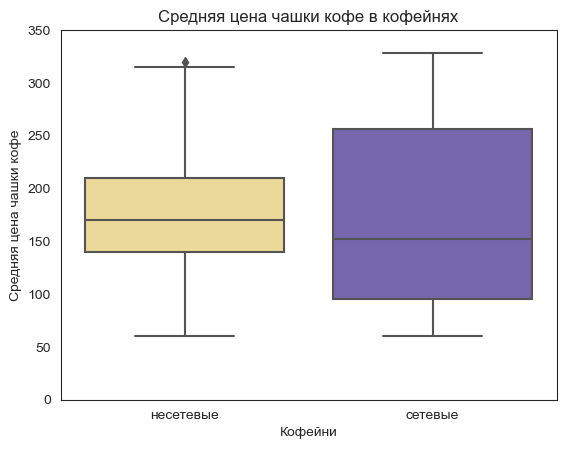

In [91]:
#визуализируем разницу в цене чашки кофе
coffee['chain']=coffee['chain'].replace(0,'несетевые')
coffee['chain']=coffee['chain'].replace(1,'сетевые')
fig = sns.boxplot(x='chain', y='middle_coffee_cup', data=coffee, palette=['#F9E18B', '#6F5ABA'])
plt.ylim(bottom=0, top=350)
plt.title('Средняя цена чашки кофе в кофейнях')
plt.xlabel('Кофейни')
plt.ylabel('Средняя цена чашки кофе')
plt.show();

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Различия в средней цене между сетевыми и несетевыми кофейнями: средний счет выше в сетевых, а цена за чашку кофе - в несетевых кофейнях, по количествй мест и кофеен лидируют сети, а рейтинг немного выше у несетевых кофеен. 
    </div>
<p></p>

#### Изучим характеристики кофеен с круглосуточным режимом работы: <a id='coffee_24_7'></a> 

In [92]:
print(f'Доля круглосуточно открытых кофеен', round((100*len(coffee.loc[coffee['is_24/7']==True])/len(coffee)), 2))

Доля круглосуточно открытых кофеен 4.18


In [93]:
#выберем данные по круглосуточным кофейням
coffee_24_7 = coffee.loc[coffee['is_24/7']==True]
coffee_24_7.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,seats
count,59.000000,59.000000,59.000000,13.000000,15.000000,37.000000
mean,55.748806,37.600844,4.206780,1423.076923,225.733333,91.648649
std,0.051938,0.095871,0.386792,805.867903,61.964813,76.506433
min,55.602350,37.371261,2.300000,0.000000,90.000000,0.000000
25%,55.730611,37.544612,4.100000,750.000000,199.500000,25.000000
50%,55.752136,37.590706,4.200000,1750.000000,256.000000,78.000000
75%,55.776908,37.653853,4.350000,2000.000000,256.000000,144.000000
max,55.878477,37.827414,5.000000,2500.000000,291.000000,320.000000


In [94]:
#выберем данные по НЕкруглосуточным кофейням
coffee_not_24_7 = coffee.loc[coffee['is_24/7']==False]
coffee_not_24_7.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,seats
count,1354.000000,1354.000000,1354.000000,187.00000,506.000000,714.000000
mean,55.756449,37.599597,4.280355,557.97861,173.553360,112.212885
std,0.064859,0.089202,0.371447,421.69628,90.054912,129.900597
min,55.581907,37.379940,1.400000,50.00000,60.000000,0.000000
25%,55.719013,37.536890,4.100000,300.00000,121.000000,40.000000
50%,55.759870,37.599118,4.300000,400.00000,165.000000,80.000000
75%,55.796748,37.656092,4.400000,725.00000,225.000000,144.000000
max,55.920257,37.864105,5.000000,2000.00000,1568.000000,1288.000000


<p></p>

<div style="border:solid black 1px; padding: 20px">
    Доля круглосуточно работающих кофеен в Москве невелика - в режиме 24/7 работаю 4.18% или 59 кофеен. Подавляющее большинство из ние (84%) относятся к сетевым заведениям. Чашка кофе в среднем обойдется в 200. Средний счет в круглосуточных кофейнях выше и составляет 1423. Пользователи в среднем оценивают кофейни на 4.2. 
    </div>
<p></p>

#### Оценим различия между кофейнями: <a id='coffee_24_7_stats'></a> 

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Нулевая гипотеза - различий в средних параметров между круглосуточными кофейнями и кофейнями с другим режимом работы нет.
    Альтернатривная гипотеза - средние параметров круглосуточных кофеен и кофеен с другим режимом работы статистически различаются.
    Примем alpha=0.01
    </div>
<p></p>

In [95]:
#Применим т-тест для независимых выборок разного размера
stat, p_value = stats.ttest_ind(coffee_24_7['middle_coffee_cup'].dropna(), coffee_not_24_7['middle_coffee_cup'].dropna(), equal_var=False)
print(f't-test: p-value={p_value:.4f}')

t-test: p-value=0.0061


In [96]:
print('Различия в средней цене чашки кофе между кофейнями составляют {0:.1%}'.format(
    coffee_24_7['middle_coffee_cup'].mean()/coffee_not_24_7['middle_coffee_cup'].mean() - 1))

Различия в средней цене чашки кофе между кофейнями составляют 30.1%


<p></p>

<div style="border:solid black 1px; padding: 20px">
   Мы можем отвергнуть нулевую гипотезу - средняя цена чашки кофе в круглосуточных кофейнях статистически значимо отличается от цены кофе в кофейнях с другим режимом работы. Для Москвы эта разница составляет 30.1%.
    </div>
<p></p>

In [97]:
stat, p_value = stats.ttest_ind(coffee_24_7['rating'].dropna(), coffee_not_24_7['rating'].dropna(), equal_var=False)
print(f't-test: p-value={p_value:.4f}')

t-test: p-value=0.1569


In [98]:
print('Различия в среднем рейтинге между кофейнями составляют {0:.1%}'.format(
    coffee_24_7['rating'].mean()/coffee_not_24_7['rating'].mean() - 1))

Различия в среднем рейтинге между кофейнями составляют -1.7%


<p></p>

<div style="border:solid black 1px; padding: 20px">
    У нас нет оснований отвергать нулевую гипотезу - рейтинг круглосуточных кофеен статистически не отличается от рейтинга кофеен с другим режимом работы. Рейтинг круглосуточных кофеен ниже на 1.7%.
    </div>
<p></p>

In [99]:
stat, p_value = stats.ttest_ind(coffee_24_7['middle_avg_bill'].dropna(), coffee_not_24_7['middle_avg_bill'].dropna(), equal_var=False)
print(f't-test: p-value={p_value:.4f}')

t-test: p-value=0.0022


In [100]:
print('Различия в среднем счете между кофейнями составляют {0:.1%}'.format(
    coffee_24_7['middle_avg_bill'].mean()/coffee_not_24_7['middle_avg_bill'].mean() - 1))

Различия в среднем счете между кофейнями составляют 155.0%


<p></p>

<div style="border:solid black 1px; padding: 20px">
    Мы можем отвергнуть нулевую гипотезу - средний счет в круглосуточных кофейнях статистически значимо отличается от средней стоимости заказа в кофейнях с другим режимом работы. Средний счет в круглосуточных кофейнях выше в 2.5 раза.
    </div>
<p></p>

#### Изучим характеристики кофеен с круглосуточным режимом работы: <a id='coffee_24_7_cup'></a> 

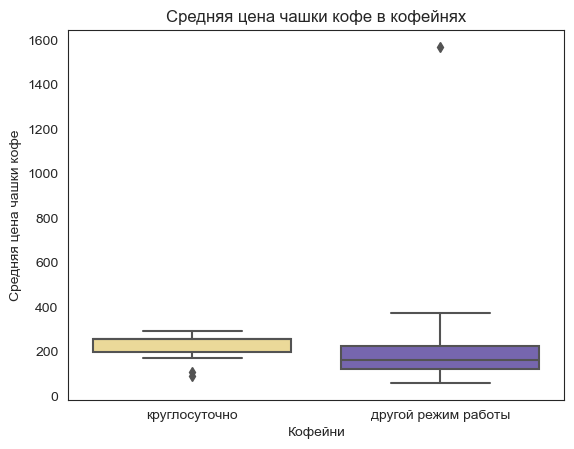

In [101]:
#визуализируем разницу в цене чашки кофе
coffee['is_24/7']=coffee['is_24/7'].replace(True,'круглосуточно')
coffee['is_24/7']=coffee['is_24/7'].replace(False,'другой режим работы')
ranks = coffee.groupby('is_24/7')['middle_coffee_cup'].median().fillna(0).sort_values()[::-1].index
fig = sns.boxplot(x='is_24/7', y='middle_coffee_cup', data=coffee, palette=['#F9E18B', '#6F5ABA'],  order = ranks)
plt.title('Средняя цена чашки кофе в кофейнях')
plt.xlabel('Кофейни')
plt.ylabel('Средняя цена чашки кофе')
plt.show();

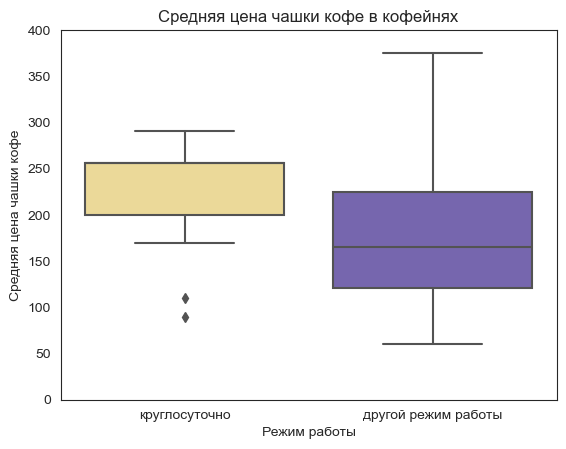

In [102]:
#укрупним диаграмму
ranks = coffee.groupby('is_24/7')['middle_coffee_cup'].median().fillna(0).sort_values()[::-1].index
fig = sns.boxplot(x='is_24/7', y='middle_coffee_cup', data=coffee, palette=['#F9E18B', '#6F5ABA'],  order = ranks)
plt.ylim(bottom=0, top=400)
plt.title('Средняя цена чашки кофе в кофейнях')
plt.xlabel('Режим работы')
plt.ylabel('Средняя цена чашки кофе')
plt.show();

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Для круглосуточных кофеен даже первй квартиль средней цены за чашку кофе выше медианы для кофеен, работающих в другом режиме. 
    </div>
<p></p>

#### Проанализируем информацию о кофейнях 24/7 по округам: <a id='coffee_24_7_to_district'></a> 

In [103]:
#подготовим таблицу с данными
coffee_dis_24_7=coffee_24_7.pivot_table(index='district', values=['name','rating', 'middle_coffee_cup', 'middle_avg_bill', 'seats'], 
              aggfunc=({'name':'count','rating':'mean','middle_coffee_cup':'median', 'middle_avg_bill':'median', 'seats':'median'}))
coffee_dis_24_7.columns=['Средний счет','Средняя цена чашки кофе','Количество кофеен','Средний рейтинг', 'Количество мест']
coffee_dis_24_7

,Средний счет,Средняя цена чашки кофе,Количество кофеен,Средний рейтинг,Количество мест
district,,,,,
Восточный административный округ,400.0,110.0,5,4.300000,49.0
Западный административный округ,1675.0,275.0,9,4.200000,48.0
Северный административный округ,NaN,285.0,5,4.220000,20.0
Северо-Восточный административный округ,NaN,170.0,3,3.866667,12.5
Северо-Западный административный округ,750.0,NaN,2,4.250000,200.0
Центральный административный округ,2000.0,256.0,26,4.288462,146.0
Юго-Восточный административный округ,NaN,NaN,1,2.300000,NaN
Юго-Западный административный округ,NaN,256.0,7,4.271429,48.0
Южный административный округ,NaN,NaN,1,4.000000,0.0


In [104]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

coffee_24_7.apply(create_clusters, axis=1)

m

<p></p>

<div style="border:solid black 1px; padding: 20px">
    Максимальное количество круглосуточных кофеен открыты в Центральном округе (26), во всех прочих районах их количество не выше 10, в Юго-Восточном и Южном округах - по одной круглосуточной кофейне. 
    </div>
<p></p>


### Вывод<a id='summary_coffee'></a> 

<p></p>

<div style="border:solid green 2px; padding: 20px">

Мы изучили более подробно данные по работе кофеен в Москве. 
На момент анализа открыто 1413 кофеен, более половины из них - сетевые. Количество мест в среднем - 80 мест. Чашка кофе в среднем стоит 170, средний счет в кофейнях - 400, медиана рейтигна 4.3.<p> 
    Различия в средней цене между сетевыми и несетевыми кофейнями: средний счет выше в сетевых, а цена за чашку кофе - в несетевых кофейнях, по количествй мест и кофеен лидируют сети, а рейтинг немного выше у несетевых кофеен.<p> 
Больше всего кофеен в Центральном административном округе, в том числе раблотающих в режиме 24/7. Во всех остальных округах доля кофеен среди заведений общественного питания ниже среднего, круглосуточных из них менее 10 в кажом округе. Меньше всего кофеен в Северо-Западном округе.
Выше среднего рейтинг кофеен в Центральном и Северо-Западном административных округах. Самый низкий рейтинг кофеен Западного и Северо-Восточного округов.
Самый дорогой кофе в Юго-западном, Центральном и Западном округах. Дешевле всего чашка кофе стоит в Восточном округе. <p>

Доля круглосуточно работающих кофеен в Москве невелика - в режиме 24/7 работаю 4.18% или 59 кофеен. Средняя цена чашки кофе и средний счет в круглосуточных кофейнях статистически значимо отличается от цены кофе в кофейнях с другим режимом работы. Чашка кофе в среднем обойдется в 200, на 30.1% дороже чем в некруглосуточных кофейнях, средний счет в круглосуточных кофейнях выше в 2.5 раза. Рейтинг круглосуточных кофеен статистически не отличается от рейтинга кофеен с другим режимом работы. <p>
</div>




##  Общий вывод <a id='summary_final'></a> 

<p></p>

<div style="border:solid green 2px; padding: 20px">

Мы проанализировала информацию о 8406 заведениях общественного питания в Москве. Пропуски в данных по средним цене заказа, счету, цене чашки кофе и ценовой категории оставлены без изменений. В ходе подготовки данных были исправлены ошибки в наименованиях и признак сетевого заведения. Выделены столбцы с наименованием улицы из адреса и признака круглосуточной работы заведения.<p> 
    Более  половины заведений общественного питания Москва приходится на долю кафе и ресторанов. Кофеен в Москве 1413, что составляети 16.8% заведений общественного питания. Пабов и баров, пиццерии, заведения быстрого питания, булочные и столовые суммарно охватывают треть рынка.<p>
   В среднем в заведениях общественного питания Москвы 75 мест, больше мест обычно в ресторанах, барах, пабах и кофейнях, меньшим количеством мест отличаются заведениях быстрого притания, кафе, булочные и пиццерии.    <p>
   Доля сетевых заведений общественного питания в Москве составляет 43.8%, этот показатель выше среди кофеен, пиццерий и булочных. Несетевых заведений больше половины - 56.2%, чаще характерно для баров, пабов, кафе и ресторанов.<p>
    Пользователи чаще всего дают заведениям общественного питания хорошие оценки - медиана рейтинга составляет 4.3, для всех категорий медиана укладывается в диапазон 4.3+/-0.1. Плохие оценки довольно редки и статистически относятся к выбросам. Наиболее высокий рейтинг в среднем у баров и пабов. Наиболее критичны пользователи к заведениям быстрого питания и кафе.<p>
   Наибольшее количество заведений общественного питания расположено в Центральном административном округе, здесь же наибольшая доля ресторанов и кофеен. В остальных округах количество заведений общественного питания не превышает 1000 (от 700 до 900 заведений в каждом округе), и более распространены кафе. Меньше 500 заведений общественного питания в Северо-Западном округе.<p>
   Наиболее высокий рейтинг в среднем у заведений общественного питания в Центральном районе, выше среднего - в Северном округе. Самые низние оценки у заведений общественного питания Юго-Восточного административного округа. <p>
  В среднем на одной улице в Москве располагаются более 5 заведений общественного питания, медиана количества заведений равна 3. Самая насышенная заведениями улица - проспект Мира, где расположены 184 заведения. Более 100 заведений общественного питания расположены всего на 5 улицах Москвы.<p>
  Значения среднего счета в заведениях общественого питания в Москве разбросаны в диапазоне от 0 до 35000. Медиана среднего чека составляет 750, среднее значение выше - 958, что говорит о наличии аномальны больших значений в отдельных заведениях. Самый высокий средний счет в медианных значениях у ресторанов и баров - 1250. В других категориях заведений медина среднего счета ниже в разы. Дешевле всего обходится питание в столовых, средний чек в которых равен 300.<p>
Во всех округах столицы находятся как догоростоящие, так и бюджетные заведения общественного питания, хотя в центре концентрация заведений с дорогими заказами выше за счет большего количества заведений всех ценовых категорий. Заведения общественного питания с круглосуточным режимом работы расположены во всех округах относительно равномерно.<p>
   Для большинства категорий работать круглосуточно невыгодно, средний счет заведений, работающих в режиме 24/7 средний счет ниже работающих в другие часы. Исключение составляют бары и пабы, у которых размер счета не меняется, а также столовые, в которых средний счет минимален. Кардинально отличается ситуация для кофеен - средний счет круглосуточных кофеен выше в 4 раза, по сравнению с работающими в другом режиме. <p>
    В Москве по имеющиейся информации открыто 1413 кофеен, более половины из них - сетевые. Количество мест в среднем - 80 мест. Чашка кофе в среднем стоит 170, средний счет в кофейнях - 400, медиана рейтигна 4.3.<p>
 Больше всего кофеен в Центральном административном округе, в том числе раблотающих в режиме 24/7. Во всех остальных округах доля кофеен среди заведений общественного питания ниже среднего, круглосуточных из них менее 10 в кажом округе. Меньше всего кофеен в Северо-Западном округе. <p>
    Выше среднего рейтинг кофеен в Центральном и Северо-Западном административных округах. Самый низкий рейтинг кофеен Западного и Северо-Восточного округов. Самый дорогой кофе в Юго-западном, Центральном и Западном округах. Дешевле всего чашка кофе стоит в Восточном округе.<p>
   Доля круглосуточно работающих кофеен в Москве невелика - в режиме 24/7 работаю 4.18% или 59 кофеен. Средняя цена чашки кофе и средний счет в круглосуточных кофейнях статистически значимо отличается от цены кофе в кофейнях с другим режимом работы. Чашка кофе в среднем обойдется в 200, на 30.1% дороже чем в некруглосуточных кофейнях, средний счет в круглосуточных кофейнях выше в 2.5 раза. Рейтинг круглосуточных кофеен статистически не отличается от рейтинга кофеен с другим режимом работы.<p>
                        
Рекомендации по открытию кофейни в Москве в порядке приоритетности:<p>

1. Юго-Восточный административный округ	- округ с самой низкой конкуренцией, одна кофейня в округе с круглосуточным режимом работы, ценовой диапазон ниже медианы по городу, рекомендуемая средняя цена за чашку кофе - 150;<p>
2. Юго-Западный административный округ	- округ с низкой конкуренцией, ценовой диапазон выше медианы по городу, рекомендуемая средняя цена за чашку кофе - 200;<p>
3. Северо-Западный административный округ	- уровень конкуренции ниже среднего, одна кофейня в округе с круглосуточным режимом работы, ценовой диапазон соответствует медиане по городу, рекомендуемая средняя цена за чашку кофе - 170;     <p>   
4. Восточный административный округ- низкий уровень конкуренции среди кофеен, ценовой диапазон ниже медианы по городу, рекомендуемая средняя цена за чашку кофе - 140;    <p>
5. Южный административный округ	- средний уровень конкуренции среди кофеен, одна кофейня в округе с круглосуточным режимом работы, ценовой диапазон ниже медианы по городу, рекомендуемая средняя цена за чашку кофе - 150;   <p>
6. Западный административный округ	- уровень конкуренции ниже среднего, ценовой диапазон выше медианы по городу, рекомендуемая средняя цена за чашку кофе - 190;<p>
7. Северо-Восточный административный округ	- уровень конкуренции ниже среднего, ценовой диапазон немного ниже медианы по городу, рекомендуемая средняя цена за чашку кофе - 160; <p>  
8. Центральный административный округ - высокая конкуренция, высокий уровень цен, рекомендуемая средняя цена за чашку кофе - 190;<p>
9. Северный административный округ- самая высокая конкуренция в городе, ценовой диапазон немного ниже медианы по городу, рекомендуемая средняя цена за чашку кофе - 160.<p>
    Режим работы при любом выбранном размещении - круглосуточный.
    
    Презентация: <https://disk.yandex.ru/i/IqpwnItFc1R0mA> 
    
</div>

